# <span style='font-family:"Times New Roman"'> <span styel=''> Convolutional Neural Networks

#### <span style='font-family:"Times New Roman"'> <span styel=''>In this project, we will use Keras deep leaning toolbox for classification. 
#### <span style='font-family:"Times New Roman"'> <span styel=''>Before starting the project, tensorflow gpu version is installed.
#### <span style='font-family:"Times New Roman"'> <span styel=''>Date: 12/09/2020:
#### <span style='font-family:"Times New Roman"'> <span styel=''>In order to use GPU on windows machine with Jupyter, following software with exact mentioned versions should be installed: 
#### <span style='font-family:"Times New Roman"'> <span styel=''>cudatoolkit: 10.1.243
#### <span style='font-family:"Times New Roman"'> <span styel=''>cudnn: 7.6.5
#### <span style='font-family:"Times New Roman"'> <span styel=''>tf: 2.3.1
#### <span style='font-family:"Times New Roman"'> <span styel=''>Otherwise, tf will use CPU for computations. 



## <span style='font-family:"Times New Roman"'> <span styel=''> Loading Required Modules:

In [1]:
from keras.utils.layer_utils import count_params
from keras.utils import to_categorical
import matplotlib.pyplot as plt 
from skimage import transform
import tensorflow as tf
import skimage.measure
import sklearn.metrics
import keras.datasets # standard datasets
import keras.models # the basic deep learning model
import keras.layers # CNN layers
import keras.utils # functions to wrangle label vectors
import scipy as sp
import numpy as np
import imageio
import shutil
import math
import glob
import time
import sys
import cv2
import os


%matplotlib inline

Using TensorFlow backend.


#### <span style='font-family:"Times New Roman"'> <span styel=''> Let’s list available devices for tensorflow:

In [2]:
tf.config.experimental.list_physical_devices()

[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU'),
 PhysicalDevice(name='/physical_device:XLA_CPU:0', device_type='XLA_CPU'),
 PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU'),
 PhysicalDevice(name='/physical_device:XLA_GPU:0', device_type='XLA_GPU')]

In [3]:
tf.config.list_physical_devices()

[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU'),
 PhysicalDevice(name='/physical_device:XLA_CPU:0', device_type='XLA_CPU'),
 PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU'),
 PhysicalDevice(name='/physical_device:XLA_GPU:0', device_type='XLA_GPU')]

In [4]:
from tensorflow.python.client import device_lib
print(device_lib.list_local_devices())

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 4701137645457556939
, name: "/device:XLA_CPU:0"
device_type: "XLA_CPU"
memory_limit: 17179869184
locality {
}
incarnation: 14217788321070143348
physical_device_desc: "device: XLA_CPU device"
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 3132581479
locality {
  bus_id: 1
  links {
  }
}
incarnation: 10686201463837808958
physical_device_desc: "device: 0, name: Quadro P1000, pci bus id: 0000:01:00.0, compute capability: 6.1"
, name: "/device:XLA_GPU:0"
device_type: "XLA_GPU"
memory_limit: 17179869184
locality {
}
incarnation: 15209861204631586938
physical_device_desc: "device: XLA_GPU device"
]


#### <span style='font-family:"Times New Roman"'> <span styel=''>XLA stands for "accelerated linear algebra". It's Tensorflow's relatively new optimizing compiler that can further speed up your ML models' GPU operations by combining what used to be multiple CUDA kernels into one (simplifying because this isn't that important for your question).

In [5]:
plt.rcParams["font.family"] = "Times New Roman"  # Setting Global Font to Times New Roman
plt.rcParams.update({'font.size': 18}) # Setting Global Font size

In [6]:
# Setting Global Path of Notebook to Avoid Hard-coding
notenookpath = os.path.abspath('') 
os.chdir(notenookpath)

## <span style='font-family:"Times New Roman"'> <span styel=''>(a) LeNet trained on MNIST.

#### <span style='font-family:"Times New Roman"'> <span styel=''>In this part, we will learn about basics of using the deep learning toolbox (keras) to define, build, train,and test deep networks. We will define the LeNet architecture and train that architecture on the MNIST dataset.

### <span style='font-family:"Times New Roman"'> <span styel=''>(a-i) Exploring the MNIST dataset:

#### <span style='font-family:"Times New Roman"'> <span styel=''>First, we need to download the MNIST dataset:

In [7]:
(X_train,y_train), (X_test, y_test) = keras.datasets.mnist.load_data()

#### <span style='font-family:"Times New Roman"'> <span styel=''>The following code wrangles the MNIST dataset variables into the format expected by keras.

In [8]:
X_train = X_train.reshape(X_train.shape[0], 28, 28, 1)
X_test = X_test.reshape(X_test.shape[0], 28, 28, 1)
Y_train = keras.utils.np_utils.to_categorical(y_train, 10)
Y_test = keras.utils.np_utils.to_categorical(y_test, 10)

#### <span style='font-family:"Times New Roman"'> <span styel=''> Now that we have the dataset downloaded and loaded into data matrices `X_train`, `X_test`, and label vectors `y_train`, `y_test`, we can explore some of the characteristics of the MNIST dataset:

In [9]:
print('X_train shape is: ')
X_train.shape

X_train shape is: 


(60000, 28, 28, 1)

In [10]:
print('X_test shape is: ')
X_test.shape

X_test shape is: 


(10000, 28, 28, 1)

In [11]:
print('Type of X_train variable is: ')
print(type(X_train))

Type of X_train variable is: 
<class 'numpy.ndarray'>


In [12]:
print('Type of X_test variable is: ')
print(type(X_test))

Type of X_test variable is: 
<class 'numpy.ndarray'>


#### <span style='font-family:"Times New Roman"'> <span styel=''>The MNIST database contains 60,000 training images and 10,000 testing images (consistent with numbers here). `X_test`, and `X_train` have general format of (x,y,z,1) where x is the number of images in variable, and y, and z denote the spatial dimension of the images. 1 stands for images being a grayscale images. Also, the variables have format of numpy.ndarray with float64 type.  

In [13]:
print('y_train shape is: ')
y_train.shape

y_train shape is: 


(60000,)

In [14]:
print('y_test shape is: ')
y_test.shape

y_test shape is: 


(10000,)

#### <span style='font-family:"Times New Roman"'> <span styel=''>`y_train` and `y_test` are labels for MNIST. As expected, `y_train` has 60,000 labels and `y_test` has 10,000 labels. The mentioned dimension are consistent with MNIST dataset. 

In [15]:
# Scaling the images to the range [0,1].
X_train = X_train/255
X_test = X_test/255

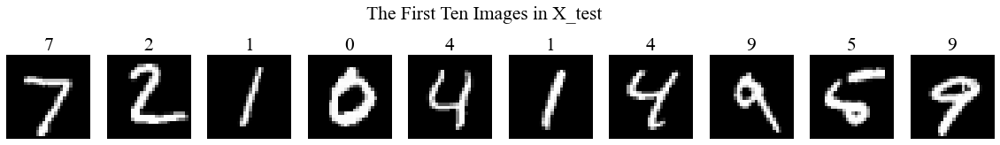

In [16]:
# Defining number of rows and columns:
nrows, ncols = 1 , 10
# Seting figure size:
plt.figure(figsize=(20,3))
for i in range (10):
    plt.subplot(nrows, ncols, i+1)
    plt.imshow(X_test[i], cmap = 'gray')
    plt.title(y_test[i])
    plt.axis('off')
plt.suptitle('The First Ten Images in X_test')
plt.show()

#### <span style='font-family:"Times New Roman"'> <span styel=''>As it can seen from last figure, there is no specific order (in terms of the digits they represent) associated with the MNIST dataset. 

#### <span style='font-family:"Times New Roman"'> <span styel=''> Displaying the first 10 images for each of the 10 digits in `X_test` :

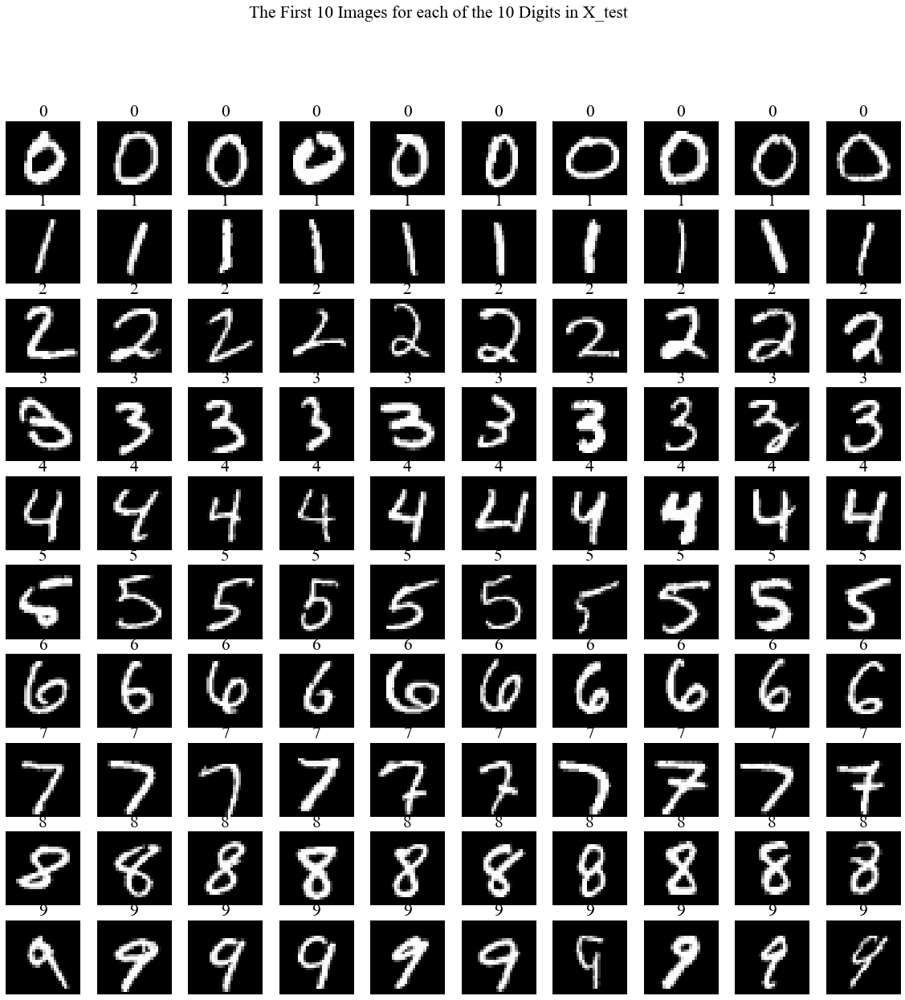

In [17]:
#Defining number of rows and columns:
nrows, ncols = 10 , 10
#Seting figure size:
plt.figure(figsize=(20,20))
k = 1
for i in range (10):
    for j in range(10):
        idx = np.where(y_test == i)[0][0:10]
        plt.subplot(nrows, ncols, k)
        plt.imshow(X_test[idx[j]], cmap = 'gray')
        plt.title(y_test[idx][j])
        plt.axis('off')
        k += 1
plt.suptitle('The First 10 Images for each of the 10 Digits in X_test')
plt.show()

#### <span style='font-family:"Times New Roman"'> <span styel=''>Since the MNIST dataset is a standard dataset generated from people handwriting, the digits appearance is different from each other.    

### <span style='font-family:"Times New Roman"'> <span styel=''>(a-ii) Defining and training the LeNet Architecture:

In [18]:
# Sequential groups a linear stack of layers into a tf.keras.Model
model1 = tf.keras.models.Sequential()
# Adding Convolution Layer
model1.add(tf.keras.layers.Convolution2D(6,(5,5), activation='relu', input_shape = (28,28,1), data_format = 'channels_last'))
# Max Pooling Layer
model1.add(tf.keras.layers.MaxPooling2D(pool_size=(2,2), data_format = 'channels_last'))
# Adding Convolution Layer
model1.add(tf.keras.layers.Convolution2D(12,(5,5), activation='relu', data_format = 'channels_last'))
# Max Pooling Layer
model1.add(tf.keras.layers.MaxPooling2D(pool_size=(2,2), data_format = 'channels_last'))
model1.add(tf.keras.layers.Flatten())
# Falttening data (14*14 = 192)
model1.add(tf.keras.layers.Dense(192, activation='relu'))
# Output Layer with 10 outputs and softmax activation function
model1.add(tf.keras.layers.Dense(10, activation='softmax'))

In [19]:
model1.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 24, 24, 6)         156       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 12, 12, 6)         0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 8, 8, 12)          1812      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 4, 4, 12)          0         
_________________________________________________________________
flatten (Flatten)            (None, 192)               0         
_________________________________________________________________
dense (Dense)                (None, 192)               37056     
_________________________________________________________________
dense_1 (Dense)              (None, 10)                1

#### <span style='font-family:"Times New Roman"'> <span styel=''>The defined model which is a small network has 40,954 parameters. In above table, the name of layer, the shape of output and number of parameters in each layers is presented. 

#### <span style='font-family:"Times New Roman"'> <span styel=''>Now that we have defined the LeNet model, we need to specify some various training options:

In [20]:
model1.compile(loss = 'categorical_crossentropy', optimizer = 'adam', metrics = ['accuracy'])

#### <span style='font-family:"Times New Roman"'> <span styel=''>Now that we have defined the optimizer parameters, we are ready to train the network using the training data

In [21]:
start_time = time.time() #For run time calculation
train_history = model1.fit(X_train, Y_train, batch_size = 64, epochs = 3, verbose = 1, validation_data = (X_test,Y_test))
Elapsed_Time = time.time() - start_time

Epoch 1/3
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
938/938 [==============================] - ETA: 0s - loss: 0.2600 - accuracy: 0.9216WARNING:tensorflow:AutoGraph could not transform <function Model.make_test_function.<locals>.test_function at 0x000002011718F558> and will run it as-is.
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`)

In [22]:
print('Training time in seconds is :')
print(Elapsed_Time)

Training time in seconds is :
11.470332384109497


#### <span style='font-family:"Times New Roman"'> <span styel=''>The training for 3 epochs takes almost 13 seconds. The network achieves validation accuracy of almost 98 percent.

### <span style='font-family:"Times New Roman"'> <span styel=''>(a-iii) Performance of the network:

#### <span style='font-family:"Times New Roman"'> <span styel=''>Predicting the labels for the test data :

In [23]:
# onehat coded prediction:
Y_test_hat = model1.predict(X_test)
# converting onehat coded prediction back to the label vector: 
y_test_hat = Y_test_hat.argmax(axis =- 1)

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


In [24]:
# Finding indices with wrong predictions
arrnotequal = np.not_equal(y_test,y_test_hat)  

In [25]:
# Extracting indices with wrong predictions
wrong_predictions_idx = [i for i, x in enumerate(arrnotequal) if x]
wrong_predictions_im = Y_test_hat[arrnotequal == True]

In [26]:
print('The Overall Accuracy Percentage is:')
print(100 * (len(y_test) - len(wrong_predictions_im)) / len(y_test))

The Overall Accuracy Percentage is:
98.51


#### <span style='font-family:"Times New Roman"'> <span styel=''> Overall accuracy is the same as validation accuracy on last epoch.  

In [27]:
# Calculating Confusion Matrix
category_filenames = np.linspace(0, 9, num=10)
C = sklearn.metrics.confusion_matrix(y_test, y_test_hat, labels = category_filenames)
print('Confusion Matrix for all dataset for classifier is: ')
print(C)

Confusion Matrix for all dataset for classifier is: 
[[ 973    0    1    0    0    0    3    1    2    0]
 [   1 1123    1    1    0    1    1    2    5    0]
 [   1    1 1020    0    1    0    0    6    3    0]
 [   0    0    3  997    0    3    0    6    1    0]
 [   0    0    0    0  976    0    1    0    1    4]
 [   2    0    0    6    0  879    3    1    0    1]
 [   5    3    1    1    1    4  943    0    0    0]
 [   0    1    5    2    0    1    0 1015    0    4]
 [   4    0    1    3    1    3    0    5  953    4]
 [   6    2    0    2    8    6    0   10    3  972]]


In [28]:
# Normalizing confusion matrix 
C = C/C.sum(axis=1)[:,None]

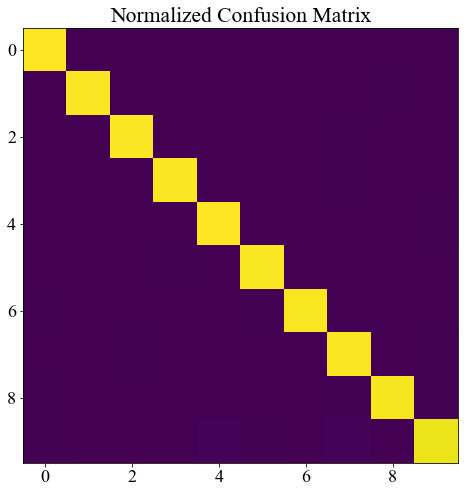

In [29]:
plt.figure(figsize=(8,8))
plt.imshow(C)
plt.title('Normalized Confusion Matrix')
plt.show()

#### <span style='font-family:"Times New Roman"'> <span styel=''>By means of confusion matrix and calculated overall accuracy, it is clear that the network has done a good job in classifying the test data. 

#### <span style='font-family:"Times New Roman"'> <span styel=''> Displaying the images that were incorrectly classified :

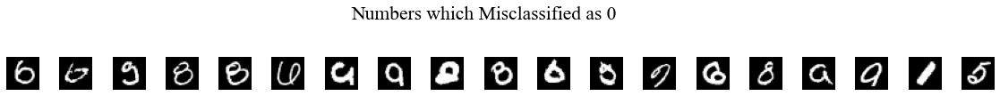

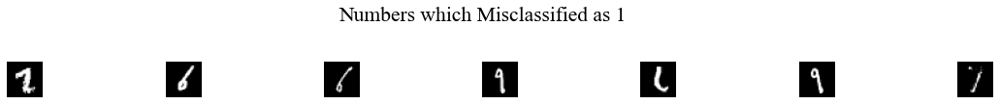

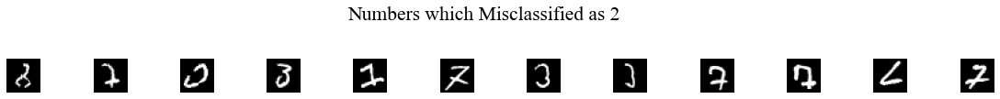

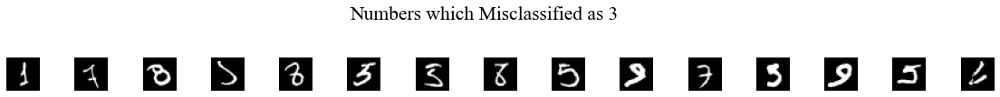

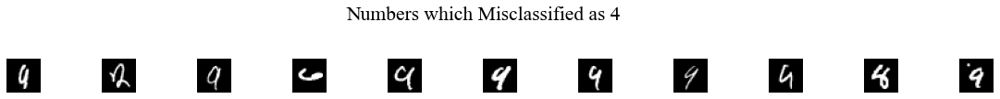

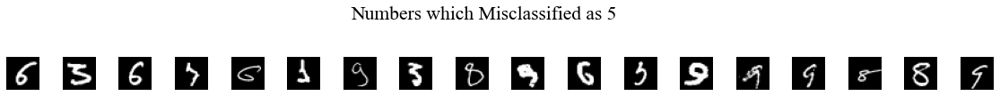

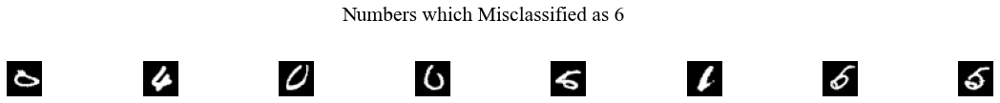

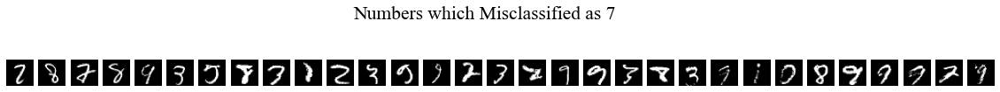

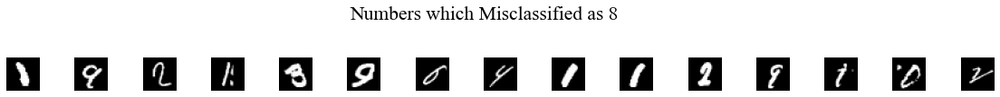

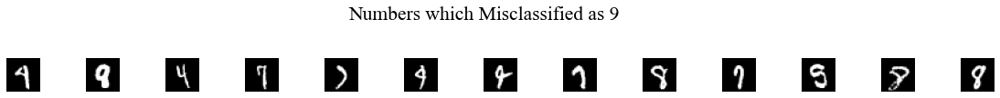

In [30]:
for i in range (10):
    plt.figure(figsize=(20,8))
    idx = np.where((y_test_hat == i) & (arrnotequal == True))
    rows, ncols = 1 , idx[0].shape[0]
    k = 1
    for j in range(idx[0].shape[0]):
        plt.subplot(nrows, ncols, k)
        plt.imshow(X_test[idx][j], cmap = 'gray')
        #plt.title(i)
        plt.axis('off')
        k += 1
    plt.suptitle('Numbers which Misclassified as ' + str(i))
plt.show()

#### <span style='font-family:"Times New Roman"'> <span styel=''>Some misclassified data does make sense to be misclassified by machine. Even, some of the misclassified data are hard to recognize by human. However, some of the misclassified data does not make sense too. 

### <span style='font-family:"Times New Roman"'> <span styel=''>(a-iv) Changing the learning rate:

#### <span style='font-family:"Times New Roman"'> <span styel=''>In the parts above, we used the adam optimizer with default parameters. This is usually a very good choice. 
#### <span style='font-family:"Times New Roman"'> <span styel=''>In this subpart, we will look at what happens if an optimizer is given a learning rate that is very small or very large.

In [31]:
models = tf.keras.models.Sequential()
models.add(tf.keras.layers.Convolution2D(6,(5,5), activation='relu', input_shape = (28,28,1), data_format = 'channels_last'))
models.add(tf.keras.layers.MaxPooling2D(pool_size=(2,2), data_format = 'channels_last'))
models.add(tf.keras.layers.Convolution2D(12,(5,5), activation='relu', data_format = 'channels_last'))
models.add(tf.keras.layers.MaxPooling2D(pool_size=(2,2), data_format = 'channels_last'))
models.add(tf.keras.layers.Flatten())
models.add(tf.keras.layers.Dense(192, activation='relu'))
models.add(tf.keras.layers.Dense(10, activation='softmax'))

In [32]:
opt = tf.keras.optimizers.Adam(learning_rate=1e-6)
models.compile(loss = 'categorical_crossentropy', optimizer = opt, metrics = ['accuracy'])

In [33]:
start_time = time.time() #For run time calculation
train_history = models.fit(X_train, Y_train, batch_size = 64, epochs = 3, verbose = 1, validation_data = (X_test,Y_test))
Elapsed_Time = time.time() - start_time

Epoch 1/3
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
929/938 [============================>.] - ETA: 0s - loss: 2.3111 - accuracy: 0.0992WARNING:tensorflow:AutoGraph could not transform <function Model.make_test_function.<locals>.test_function at 0x00000202197F53A8> and will run it as-is.
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`)

In [34]:
print('Training time in seconds is :')
print(Elapsed_Time)

Training time in seconds is :
10.24932336807251


In [35]:
modelf = tf.keras.models.Sequential()
modelf.add(tf.keras.layers.Convolution2D(6,(5,5), activation='relu', input_shape = (28,28,1), data_format = 'channels_last'))
modelf.add(tf.keras.layers.MaxPooling2D(pool_size=(2,2), data_format = 'channels_last'))
modelf.add(tf.keras.layers.Convolution2D(12,(5,5), activation='relu', data_format = 'channels_last'))
modelf.add(tf.keras.layers.MaxPooling2D(pool_size=(2,2), data_format = 'channels_last'))
modelf.add(tf.keras.layers.Flatten())
modelf.add(tf.keras.layers.Dense(192, activation='relu'))
modelf.add(tf.keras.layers.Dense(10, activation='softmax'))

In [36]:
opt = tf.keras.optimizers.Adam(learning_rate = 1)
modelf.compile(loss = 'categorical_crossentropy', optimizer = opt, metrics = ['accuracy'])

In [37]:
start_time = time.time() #For run time calculation
train_history = modelf.fit(X_train, Y_train, batch_size = 64, epochs = 3, verbose = 1, validation_data = (X_test,Y_test))
Elapsed_Time = time.time() - start_time

Epoch 1/3
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
935/938 [============================>.] - ETA: 0s - loss: 683.1372 - accuracy: 0.1031WARNING:tensorflow:AutoGraph could not transform <function Model.make_test_function.<locals>.test_function at 0x0000020217951DC8> and will run it as-is.
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10

In [38]:
print('Training time in seconds is :')
print(Elapsed_Time)

Training time in seconds is :
10.286706686019897


#### <span style='font-family:"Times New Roman"'> <span styel=''>The default learning rate for Adam optimizer is 0.001. In this section, we have selected two different learning rates: 1e-6 and 1. The selected learning rates are either too small or too large to converge. Hence, the trained network has convergence problem reaching below 29 percent of validation accuracy with learning rate 1e-6 and below 11 percent with learning rate of 1.

## <span style='font-family:"Times New Roman"'> <span styel=''>(b) Text Summaries of a Network.

#### <span style='font-family:"Times New Roman"'> <span styel=''>In this part, we will learn some basics of how to explore the network architecture through various text summaries.

### <span style='font-family:"Times New Roman"'> <span styel=''>(b-i) Input and output tensor shapes:

#### <span style='font-family:"Times New Roman"'> <span styel=''> Following function would print a layer-by-layer summary of the architecture with columns Layer Name, Layer Type, Input Shape, Output Shape, and Trainable.

In [39]:
def print_shapes(model):
    # Loop over the layers of model
    for i in range (len(model.layers)):
        layer = model.layers[i]
        # Printing empty space for better display
        print('')
        # Printing number of layer
        print('The Layer ' + str(i) + ' Features are :')
        # Layer name
        print("Layer Name:", layer.name)
        # Layer type
        print("Layer Type:", layer.__class__.__name__)
        # Input layer shape 
        print("Input Shape:", layer.input_shape)
        # Output layer shape
        print("Output Shape:", layer.output_shape)
        # Weight features
        if len(layer.trainable_weights) >= 1:
            print ("Trainable : Yes")
        else:
            print ("Trainable : No")

In [40]:
print_shapes(model1)


The Layer 0 Features are :
Layer Name: conv2d
Layer Type: Conv2D
Input Shape: (None, 28, 28, 1)
Output Shape: (None, 24, 24, 6)
Trainable : Yes

The Layer 1 Features are :
Layer Name: max_pooling2d
Layer Type: MaxPooling2D
Input Shape: (None, 24, 24, 6)
Output Shape: (None, 12, 12, 6)
Trainable : No

The Layer 2 Features are :
Layer Name: conv2d_1
Layer Type: Conv2D
Input Shape: (None, 12, 12, 6)
Output Shape: (None, 8, 8, 12)
Trainable : Yes

The Layer 3 Features are :
Layer Name: max_pooling2d_1
Layer Type: MaxPooling2D
Input Shape: (None, 8, 8, 12)
Output Shape: (None, 4, 4, 12)
Trainable : No

The Layer 4 Features are :
Layer Name: flatten
Layer Type: Flatten
Input Shape: (None, 4, 4, 12)
Output Shape: (None, 192)
Trainable : No

The Layer 5 Features are :
Layer Name: dense
Layer Type: Dense
Input Shape: (None, 192)
Output Shape: (None, 192)
Trainable : Yes

The Layer 6 Features are :
Layer Name: dense_1
Layer Type: Dense
Input Shape: (None, 192)
Output Shape: (None, 10)
Trainable

### <span style='font-family:"Times New Roman"'> <span styel=''>(b-ii) Filter shapes and number of parameters:

#### <span style='font-family:"Times New Roman"'> <span styel=''> Following function would print a layer-by-layer summary of the architecture with columns Layer name, Layer Type, Filter Shape, # Parameters, Trainable.

In [41]:
def print_params(model):
    # Loop over the layers of model
    for i in range (len(model.layers)):
        layer = model.layers[i]
        # Printing empty space for better display
        print('')
        # Printing number of layer
        print('The Layer ' + str(i) + ' Features are :')
        # Layer name
        print("Layer Name:", layer.name)
        # Layer type
        print("Layer Type:", layer.__class__.__name__)
        if 'conv' not in layer.name and 'dense' not in layer.name:
            continue
        if len(layer.trainable_weights) >= 1:
            print ("Trainable : Yes")
        else:
            print ("Trainable : No")        
        filters, biases = layer.get_weights()
        # Printing filter shape
        print('Filter Shape is :', filters.shape)
        # Printing number of biases
        print('Number of Biases :', len(biases))
        # Printing number of weights
        print('Number of Weights :', len(layer.get_weights()[0]))
        # Printing number of parameters
        print('Number of Parameters is :', layer.count_params())
        # Printing number of Trainable Parameters
        print('Number of Total Trainable Parameters :', count_params(layer.trainable_weights))
        # Printing number of Untrainable Parameters
        print('Number of Total Untrainable Parameters :', count_params(layer.non_trainable_weights))

In [42]:
print_params(model1)


The Layer 0 Features are :
Layer Name: conv2d
Layer Type: Conv2D
Trainable : Yes
Filter Shape is : (5, 5, 1, 6)
Number of Biases : 6
Number of Weights : 5
Number of Parameters is : 156
Number of Total Trainable Parameters : 156
Number of Total Untrainable Parameters : 0

The Layer 1 Features are :
Layer Name: max_pooling2d
Layer Type: MaxPooling2D

The Layer 2 Features are :
Layer Name: conv2d_1
Layer Type: Conv2D
Trainable : Yes
Filter Shape is : (5, 5, 6, 12)
Number of Biases : 12
Number of Weights : 5
Number of Parameters is : 1812
Number of Total Trainable Parameters : 1812
Number of Total Untrainable Parameters : 0

The Layer 3 Features are :
Layer Name: max_pooling2d_1
Layer Type: MaxPooling2D

The Layer 4 Features are :
Layer Name: flatten
Layer Type: Flatten

The Layer 5 Features are :
Layer Name: dense
Layer Type: Dense
Trainable : Yes
Filter Shape is : (192, 192)
Number of Biases : 192
Number of Weights : 192
Number of Parameters is : 37056
Number of Total Trainable Paramete

## <span style='font-family:"Times New Roman"'> <span styel=''>(c) Visualizing Weights and Activations of a Network.

#### <span style='font-family:"Times New Roman"'> <span styel=''>In this part we will learn some basics of how to explore the learned weights and activations of the network architecture.

### <span style='font-family:"Times New Roman"'> <span styel=''>(c-i) Filter weights:

In [43]:
# Accessing learned filter weights for the first layer
layer = model1.layers[0]
# Getting the weights 
weight = layer.get_weights()

#### <span style='font-family:"Times New Roman"'> <span styel=''> We will only display the filter weights for the convolutional layers.

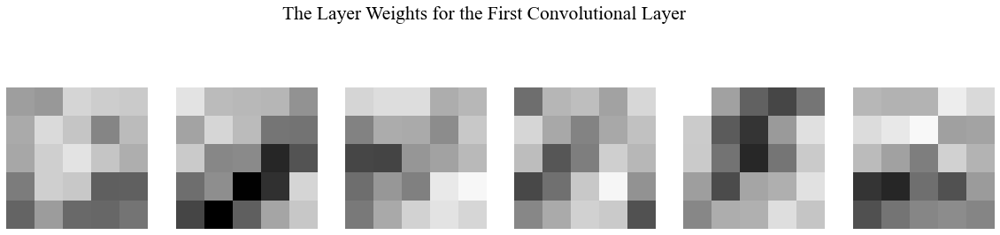

In [44]:
nrows, ncols = weight[0].shape[2] , weight[0].shape[3]
plt.figure(figsize=(20,5))
for i in range(weight[0].shape[3]):
    plt.subplot(nrows, ncols, i+1)
    plt.imshow(weight[0][:,:,:,i], cmap = 'gray', vmin = np.min(weight[0]) , vmax = np.max(weight[0]))
    plt.axis('off')
plt.suptitle('The Layer Weights for the First Convolutional Layer')
plt.show()

In [45]:
layer = model1.layers[2]
weight = layer.get_weights()

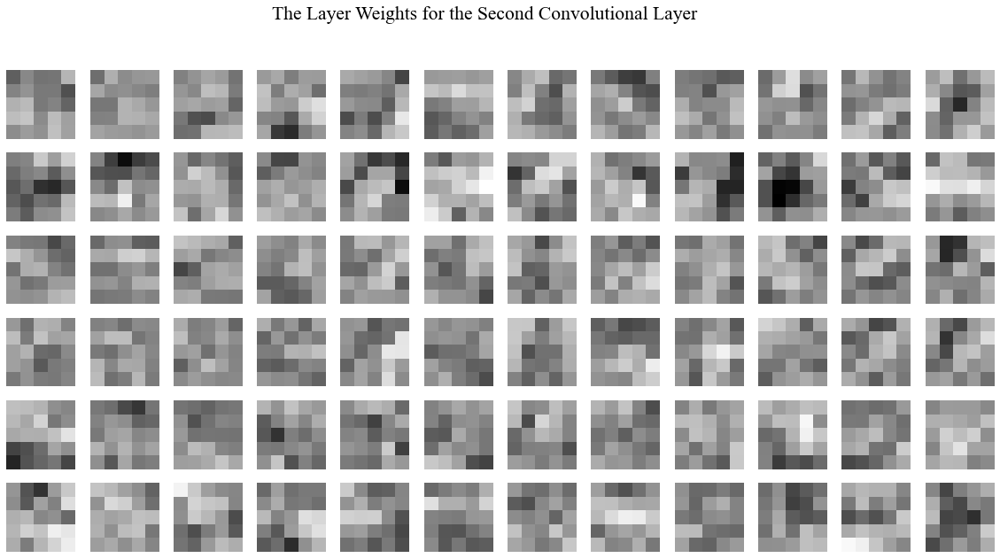

In [46]:
nrows, ncols = weight[0].shape[2] , weight[0].shape[3]
plt.figure(figsize=(20,10))
k = 1
for j in range(weight[0].shape[2]):
    for i in range(weight[0].shape[3]):
        plt.subplot(nrows, ncols, k)
        plt.imshow(weight[0][:,:,j,i], cmap = 'gray', vmin = np.min(weight[0]) , vmax = np.max(weight[0]))
        plt.axis('off')
        k += 1
plt.suptitle('The Layer Weights for the Second Convolutional Layer')
plt.show()

### <span style='font-family:"Times New Roman"'> <span styel=''>(c-ii) Activations I:

In [47]:
X_example = X_test[0]
X_example = np.reshape(X_example,((1,28, 28, 1)))

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


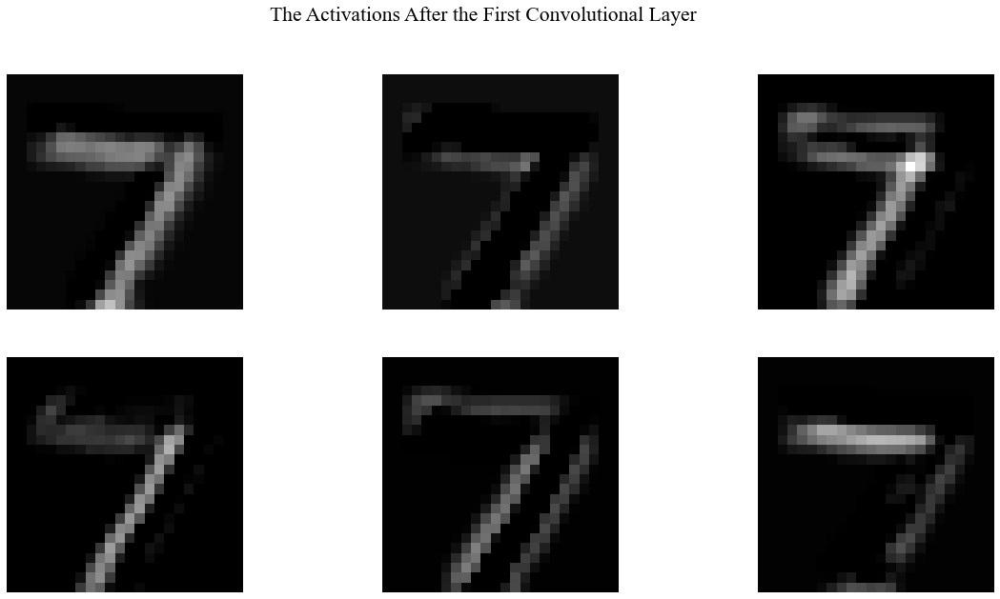

In [48]:
model1_layeri = tf.keras.models.Model(inputs = model1.inputs, outputs = model1.layers[0].output)
layeri_acts = model1_layeri.predict(X_example);
nrows, ncols = 2 , 3
plt.figure(figsize=(20,10))
k = 1
for i in range(layeri_acts.shape[3]):
    plt.subplot(nrows, ncols, k)
    plt.imshow(layeri_acts[0,:,:,i], cmap = 'gray', vmin = np.min(layeri_acts) , vmax = np.max(layeri_acts))
    plt.axis('off')
    k += 1
plt.suptitle('The Activations After the First Convolutional Layer')
plt.show()

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


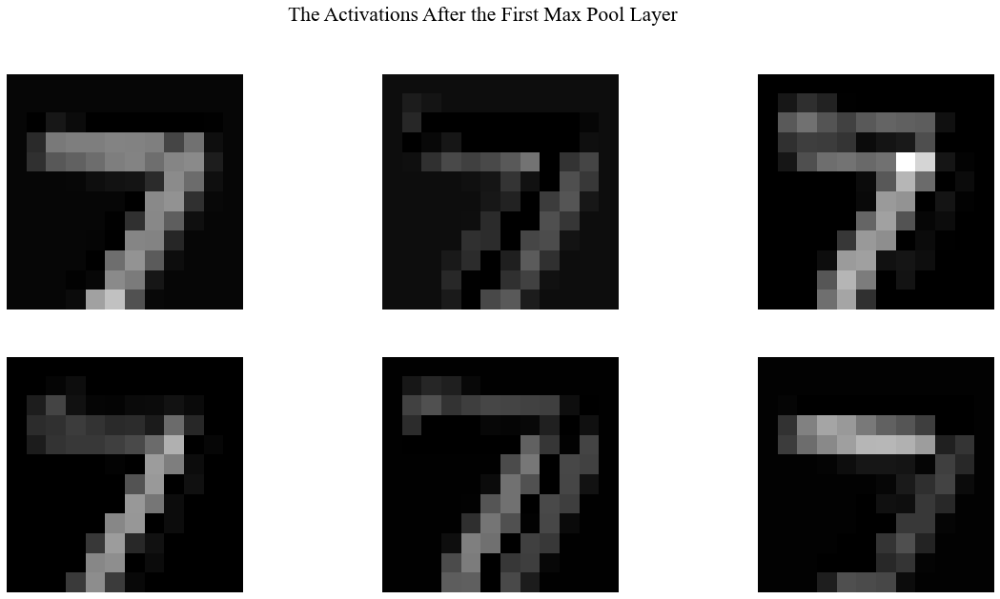

In [49]:
model1_layeri = tf.keras.models.Model(inputs = model1.inputs, outputs = model1.layers[1].output)
layeri_acts = model1_layeri.predict(X_example);
nrows, ncols = 2 , 3
plt.figure(figsize=(20,10))
k = 1
for i in range(layeri_acts.shape[3]):
    plt.subplot(nrows, ncols, k)
    plt.imshow(layeri_acts[0,:,:,i], cmap = 'gray', vmin = np.min(layeri_acts) , vmax = np.max(layeri_acts))
    plt.axis('off')
    k += 1
plt.suptitle('The Activations After the First Max Pool Layer')
plt.show()

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


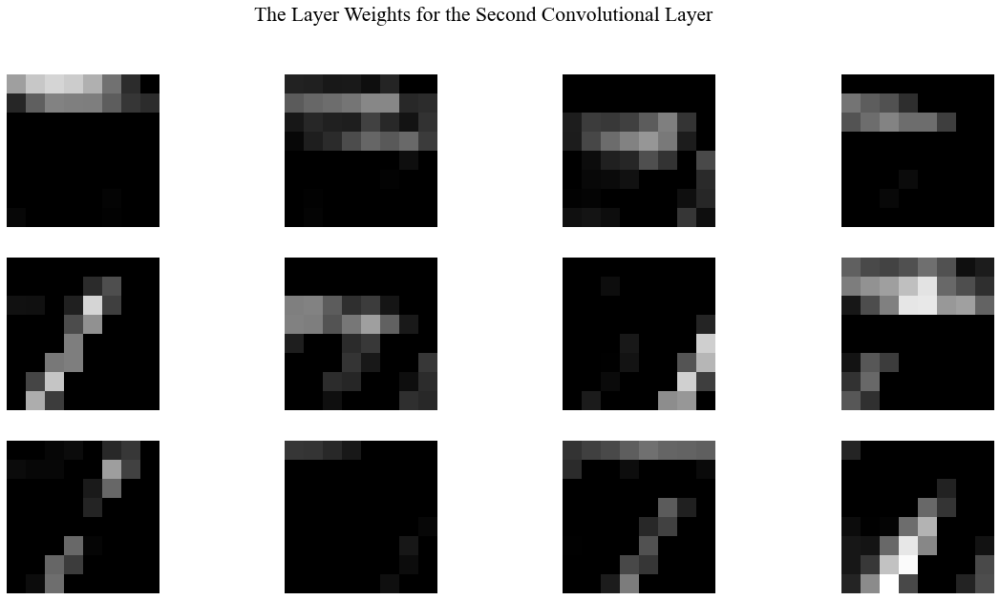

In [50]:
model1_layeri = tf.keras.models.Model(inputs = model1.inputs, outputs = model1.layers[2].output)
layeri_acts = model1_layeri.predict(X_example);
nrows, ncols = 3 , 4
plt.figure(figsize=(20,10))
k = 1
for i in range(layeri_acts.shape[3]):
    plt.subplot(nrows, ncols, k)
    plt.imshow(layeri_acts[0,:,:,i], cmap = 'gray', vmin = np.min(layeri_acts) , vmax = np.max(layeri_acts))
    plt.axis('off')
    k += 1
plt.suptitle('The Layer Weights for the Second Convolutional Layer')
plt.show()

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


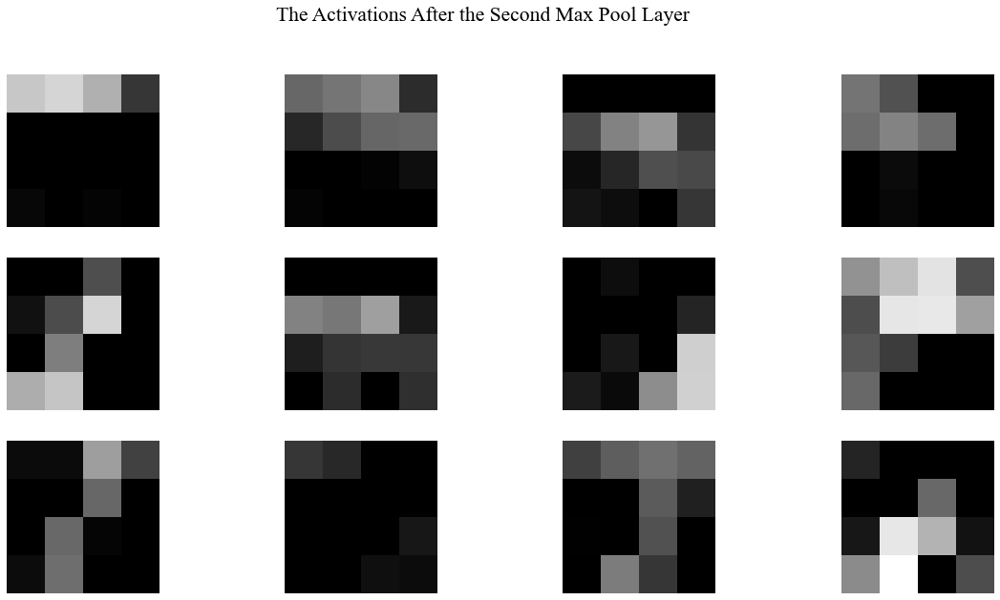

In [51]:
model1_layeri = tf.keras.models.Model(inputs = model1.inputs, outputs = model1.layers[3].output)
layeri_acts = model1_layeri.predict(X_example);
nrows, ncols = 3 , 4
plt.figure(figsize=(20,10))
k = 1
for i in range(layeri_acts.shape[3]):
    plt.subplot(nrows, ncols, k)
    plt.imshow(layeri_acts[0,:,:,i], cmap = 'gray', vmin = np.min(layeri_acts) , vmax = np.max(layeri_acts))
    plt.axis('off')
    k += 1
plt.suptitle('The Activations After the Second Max Pool Layer')
plt.show()

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


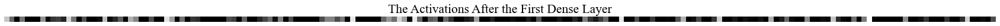

In [52]:
model1_layeri = tf.keras.models.Model(inputs = model1.inputs, outputs = model1.layers[4].output)
layeri_acts = model1_layeri.predict(X_example);
plt.figure(figsize=(30,2))
plt.imshow(layeri_acts, cmap = 'gray', vmin = np.min(layeri_acts) , vmax = np.max(layeri_acts))
plt.axis('off')
plt.title('The Activations After the First Dense Layer')
plt.show()

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


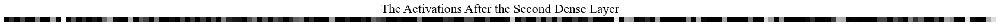

In [53]:
model1_layeri = tf.keras.models.Model(inputs = model1.inputs, outputs = model1.layers[5].output)
layeri_acts = model1_layeri.predict(X_example);
plt.figure(figsize=(30,2))
plt.imshow(layeri_acts, cmap = 'gray', vmin = np.min(layeri_acts) , vmax = np.max(layeri_acts))
plt.axis('off')
plt.title('The Activations After the Second Dense Layer')
plt.show()

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


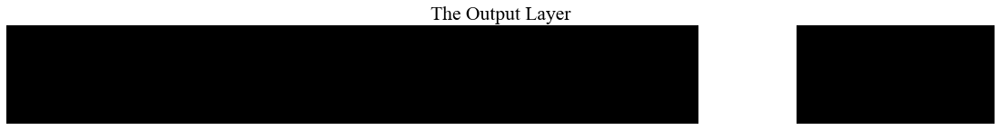

In [54]:
model1_layeri = tf.keras.models.Model(inputs = model1.inputs, outputs = model1.layers[6].output)
layeri_acts = model1_layeri.predict(X_example);
plt.figure(figsize=(30,2))
plt.imshow(layeri_acts, cmap = 'gray', vmin = np.min(layeri_acts) , vmax = np.max(layeri_acts))
plt.axis('off')
plt.title('The Output Layer')
plt.show()

### <span style='font-family:"Times New Roman"'> <span styel=''>This part presented activations of our network for number 7. As shown, the activations become abstract as we move forward in our network. For instance, one can clearly see number 7 by looking at activation after the first convolutional layer. However, it is difficult to guess number 7 after looking at activations after second convolutional layer. 
### <span style='font-family:"Times New Roman"'> <span styel=''>The network seems to learn number 7 by looking at its edges, and its horizontal and vertical structures as well as inclined structures.  


### <span style='font-family:"Times New Roman"'> <span styel=''>(c-ii) Activations II:

In [55]:
X_example = X_test[85]
X_example = np.reshape(X_example,((1,28, 28, 1)))

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


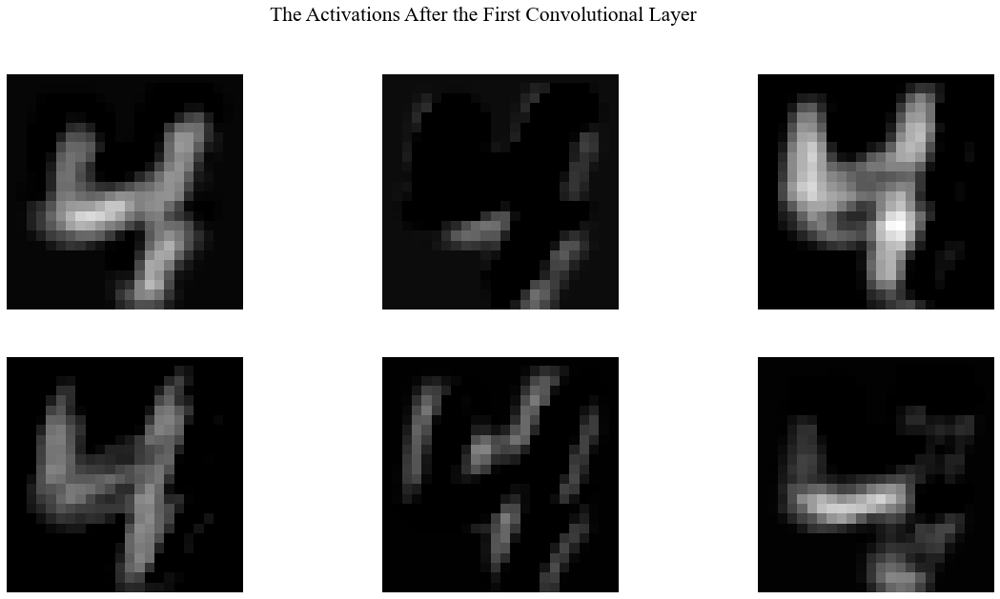

In [56]:
model1_layeri = tf.keras.models.Model(inputs = model1.inputs, outputs = model1.layers[0].output)
layeri_acts = model1_layeri.predict(X_example);
nrows, ncols = 2 , 3
plt.figure(figsize=(20,10))
k = 1
for i in range(layeri_acts.shape[3]):
    plt.subplot(nrows, ncols, k)
    plt.imshow(layeri_acts[0,:,:,i], cmap = 'gray', vmin = np.min(layeri_acts) , vmax = np.max(layeri_acts))
    plt.axis('off')
    k += 1
plt.suptitle('The Activations After the First Convolutional Layer')
plt.show()

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


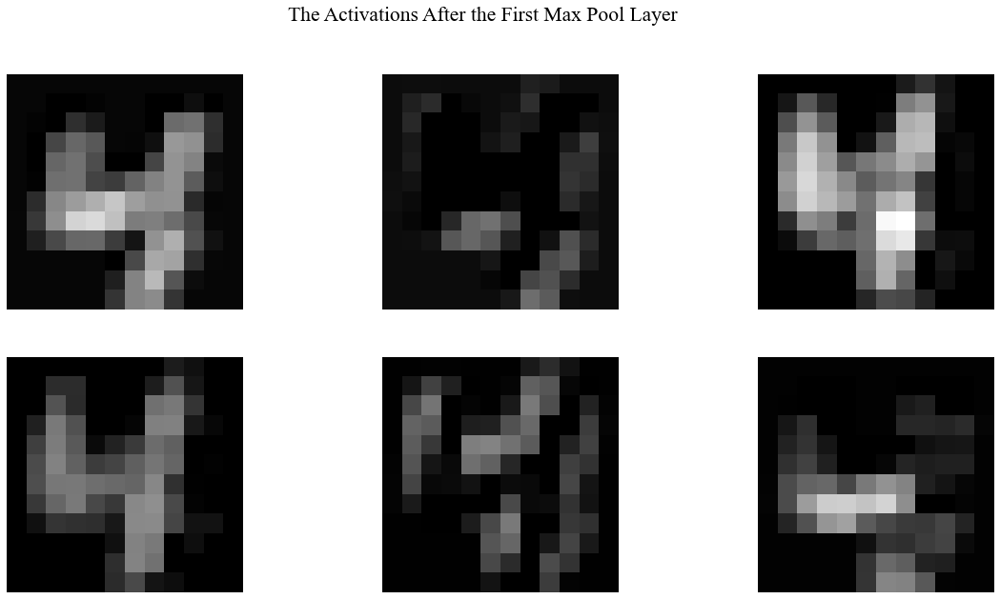

In [57]:
model1_layeri = tf.keras.models.Model(inputs = model1.inputs, outputs = model1.layers[1].output)
layeri_acts = model1_layeri.predict(X_example);
nrows, ncols = 2 , 3
plt.figure(figsize=(20,10))
k = 1
for i in range(layeri_acts.shape[3]):
    plt.subplot(nrows, ncols, k)
    plt.imshow(layeri_acts[0,:,:,i], cmap = 'gray', vmin = np.min(layeri_acts) , vmax = np.max(layeri_acts))
    plt.axis('off')
    k += 1
plt.suptitle('The Activations After the First Max Pool Layer')
plt.show()

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


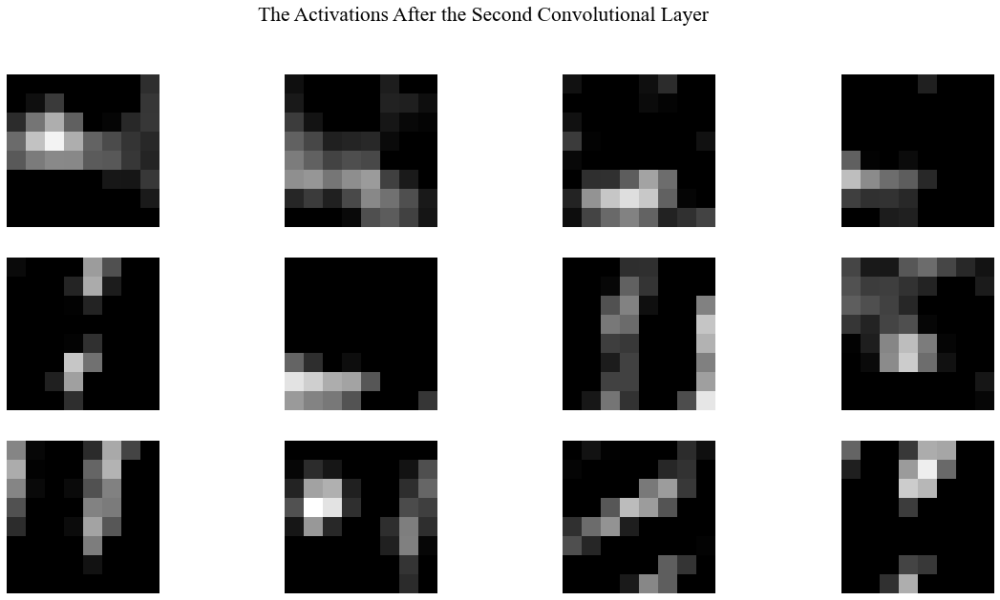

In [58]:
model1_layeri = tf.keras.models.Model(inputs = model1.inputs, outputs = model1.layers[2].output)
layeri_acts = model1_layeri.predict(X_example);
nrows, ncols = 3 , 4
plt.figure(figsize=(20,10))
k = 1
for i in range(layeri_acts.shape[3]):
    plt.subplot(nrows, ncols, k)
    plt.imshow(layeri_acts[0,:,:,i], cmap = 'gray', vmin = np.min(layeri_acts) , vmax = np.max(layeri_acts))
    plt.axis('off')
    k += 1
plt.suptitle('The Activations After the Second Convolutional Layer')
plt.show()

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


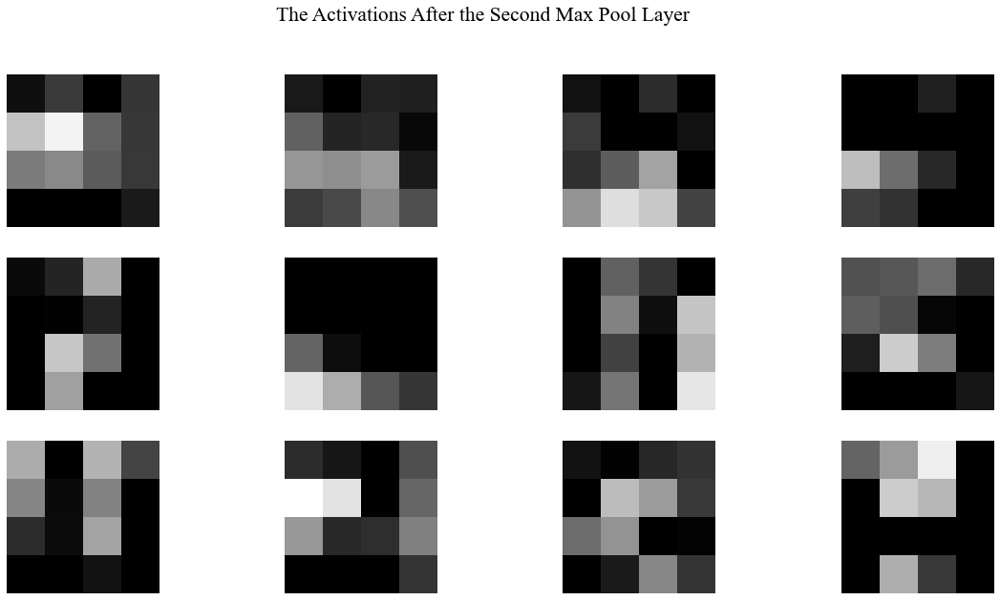

In [59]:
model1_layeri = tf.keras.models.Model(inputs = model1.inputs, outputs = model1.layers[3].output)
layeri_acts = model1_layeri.predict(X_example);
nrows, ncols = 3 , 4
plt.figure(figsize=(20,10))
k = 1
for i in range(layeri_acts.shape[3]):
    plt.subplot(nrows, ncols, k)
    plt.imshow(layeri_acts[0,:,:,i], cmap = 'gray', vmin = np.min(layeri_acts) , vmax = np.max(layeri_acts))
    plt.axis('off')
    k += 1
plt.suptitle('The Activations After the Second Max Pool Layer')
plt.show()

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


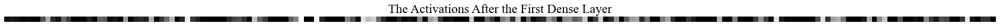

In [60]:
model1_layeri = tf.keras.models.Model(inputs = model1.inputs, outputs = model1.layers[4].output)
layeri_acts = model1_layeri.predict(X_example);
plt.figure(figsize=(30,2))
plt.imshow(layeri_acts, cmap = 'gray', vmin = np.min(layeri_acts) , vmax = np.max(layeri_acts))
plt.axis('off')
plt.title('The Activations After the First Dense Layer')
plt.show()

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


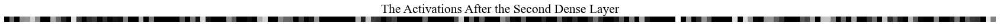

In [61]:
model1_layeri = tf.keras.models.Model(inputs = model1.inputs, outputs = model1.layers[5].output)
layeri_acts = model1_layeri.predict(X_example);
plt.figure(figsize=(30,2))
plt.imshow(layeri_acts, cmap = 'gray', vmin = np.min(layeri_acts) , vmax = np.max(layeri_acts))
plt.axis('off')
plt.title('The Activations After the Second Dense Layer')
plt.show()

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


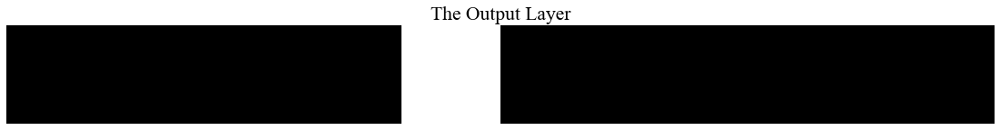

In [62]:
model1_layeri = tf.keras.models.Model(inputs = model1.inputs, outputs = model1.layers[6].output)
layeri_acts = model1_layeri.predict(X_example);
plt.figure(figsize=(30,2))
plt.imshow(layeri_acts, cmap = 'gray', vmin = np.min(layeri_acts) , vmax = np.max(layeri_acts))
plt.axis('off')
plt.title('The Output Layer')
plt.show()

#### <span style='font-family:"Times New Roman"'> <span styel=''>This part presented activations of our network for number 4. Like last subsection, the activations become abstract as we move forward in our network. For instance, one can clearly see number 4 by looking at activation after the first convolutional layer. However, it is difficult to guess number 4 after looking at activations after second convolutional layer. 
#### <span style='font-family:"Times New Roman"'> <span styel=''>The network seems to learn number 4 by looking at its edges, and its horizontal and vertical structures as well as inclined structures.  


## <span style='font-family:"Times New Roman"'> <span styel=''>(d) Train LeNet on CIFAR10.

#### <span style='font-family:"Times New Roman"'> <span styel=''>In this part, we will train a LeNet-like architecture on the CIFAR10 dataset. The CIFAR10 dataset consists of 32×32 pixel color images in 10 categories with 50,000 training images and 10,000 test images. It is thus of similar size to the MNIST dataset.

### <span style='font-family:"Times New Roman"'> <span styel=''>(d-i) Exploring the CIFAR10 dataset:

In [63]:
(X2_train, y2_train), (X2_test, y2_test) = keras.datasets.cifar10.load_data()

#### <span style='font-family:"Times New Roman"'> <span styel=''>The following code wrangles the CIFAR10 dataset variables into the format expected by keras.

In [64]:
X2_train = X2_train.reshape(X2_train.shape[0], 32, 32, 3)
X2_test = X2_test.reshape(X2_test.shape[0], 32, 32, 3)
Y2_train = keras.utils.np_utils.to_categorical(y2_train, 10)
Y2_test = keras.utils.np_utils.to_categorical(y2_test, 10)

#### <span style='font-family:"Times New Roman"'> <span styel=''> Now that we have the dataset downloaded and loaded into data matrices `X_train`, `X_test`, and label vectors `y_train`, `y_test`, we can explore some of the characteristics of the CIFAR10 dataset:

In [65]:
print('X2_train shape is: ')
print(X2_train.shape)

X2_train shape is: 
(50000, 32, 32, 3)


In [66]:
print('Type of X2_train variable is: ')
print(type(X2_train))

Type of X2_train variable is: 
<class 'numpy.ndarray'>


In [67]:
print('X2_test shape is: ')
print(X2_test.shape)

X2_test shape is: 
(10000, 32, 32, 3)


In [68]:
print('Type of X2_test variable is: ')
print(type(X2_test))

Type of X2_test variable is: 
<class 'numpy.ndarray'>


In [69]:
print('y2_train shape is: ')
print(y2_train.shape)

y2_train shape is: 
(50000, 1)


In [70]:
print('Type of y2_train variable is: ')
print(type(y2_train))

Type of y2_train variable is: 
<class 'numpy.ndarray'>


In [71]:
print('y2_test shape is: ')
print(y2_test.shape)

y2_test shape is: 
(10000, 1)


In [72]:
print('Type of y2_test variable is: ')
print(type(y2_test))

Type of y2_test variable is: 
<class 'numpy.ndarray'>


#### <span style='font-family:"Times New Roman"'> <span styel=''>The CIFAR10 database contains 50,000 training images and 10,000 testing images (consistent with numbers here). `X_test`, and `X_train` have general format of (x,y,z,3) where x is the number of images in variable, and y, and z denote the spatial dimension of the images. 3 stands for RGB images. Also, the variables have format of numpy.ndarray with float64 type.  #### <span style='font-family:"Times New Roman"'> <span styel=''>`y_train` and `y_test` are labels for CIFAR10. As expected, `y_train` has 50,000 labels and `y_test` has 10,000 labels. The mentioned dimension are consistent with MNIST dataset. 

In [73]:
# Scaling the images to the range [0,1].
X2_train = X2_train/255
X2_test = X2_test/255

#### <span style='font-family:"Times New Roman"'> <span styel=''> Displaying the first 10 images in X2_test:

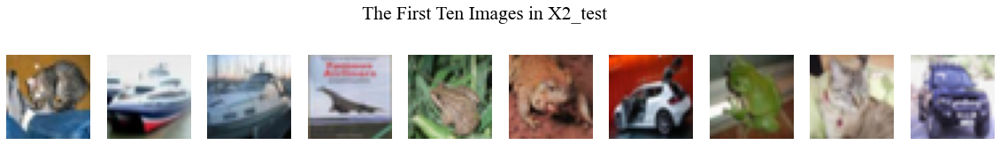

In [74]:
# Defining number of rows and columns:
nrows, ncols = 1 , 10
# Seting figure size:
plt.figure(figsize=(20,3))
for i in range (10):
    plt.subplot(nrows, ncols, i+1)
    plt.imshow(X2_test[i])
    plt.axis('off')
plt.suptitle('The First Ten Images in X2_test')
plt.show()

#### <span style='font-family:"Times New Roman"'> <span styel=''> Displaying the first 10 images for each of the 10 categories:

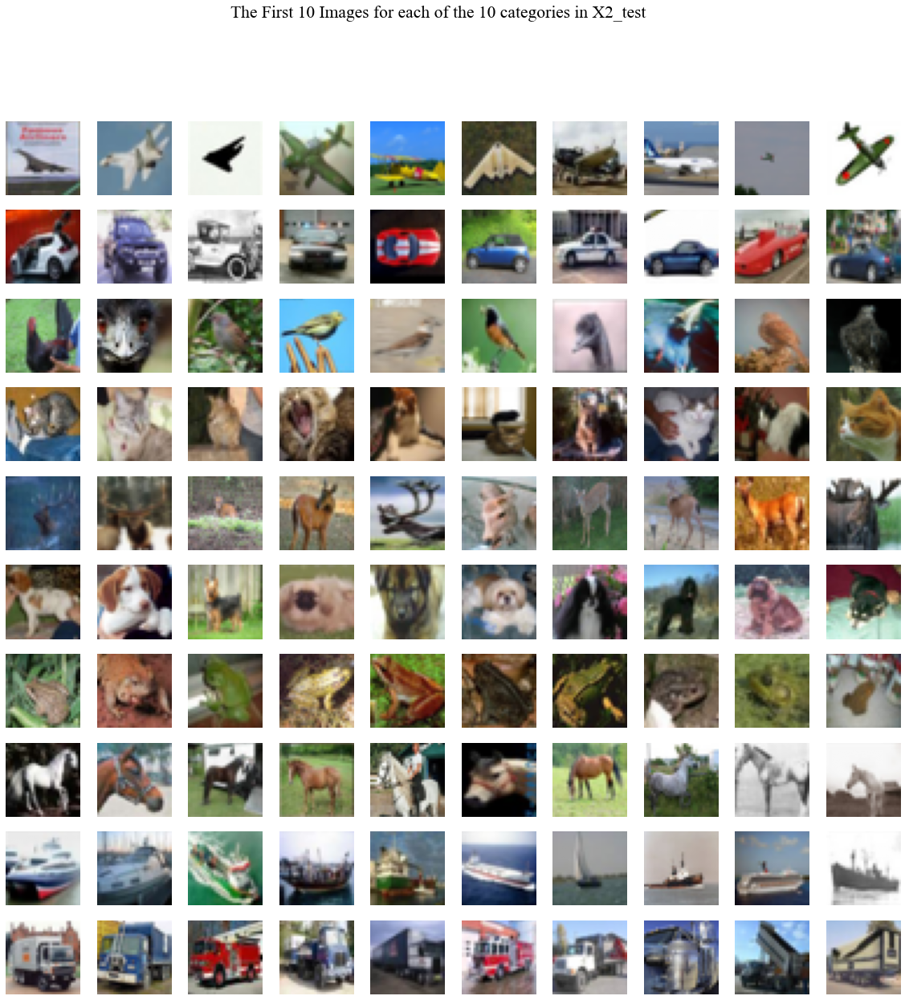

In [75]:
#Defining number of rows and columns:
nrows, ncols = 10 , 10
#Seting figure size:
plt.figure(figsize=(20,20))
k = 1
for i in range (10):
    for j in range(10):
        idx = np.where(y2_test == i)[0][0:10]
        plt.subplot(nrows, ncols, k)
        plt.imshow(X2_test[idx[j]])
        plt.axis('off')
        k += 1
plt.suptitle('The First 10 Images for each of the 10 categories in X2_test')
plt.show()

### <span style='font-family:"Times New Roman"'> <span styel=''>(d-ii) Defining and training the CIFAR10 LeNet architecture:

#### <span style='font-family:"Times New Roman"'> <span styel=''> In this section, for CIFAR10 dataset, same network architecture as part (a) is leveraged. Just the input shape has changed since the CIFAR10 images shape is different from MNIST.   

In [76]:
# Sequential groups a linear stack of layers into a tf.keras.Model
model2 = tf.keras.models.Sequential()
# Adding Convolution Layer
model2.add(tf.keras.layers.Convolution2D(6,(5,5), activation='relu', input_shape = (32,32,3), data_format = 'channels_last'))
# Max Pooling Layer
model2.add(tf.keras.layers.MaxPooling2D(pool_size=(2,2), data_format = 'channels_last'))
# Adding Convolution Layer
model2.add(tf.keras.layers.Convolution2D(12,(5,5), activation='relu', data_format = 'channels_last'))
# Max Pooling Layer
model2.add(tf.keras.layers.MaxPooling2D(pool_size=(2,2), data_format = 'channels_last'))
# Falttening data
model2.add(tf.keras.layers.Flatten())
# Dense Layer
model2.add(tf.keras.layers.Dense(192, activation='relu'))
# Output Layer with 10 outputs and softmax activation function
model2.add(tf.keras.layers.Dense(10, activation='softmax'))

In [77]:
model2.summary()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_6 (Conv2D)            (None, 28, 28, 6)         456       
_________________________________________________________________
max_pooling2d_6 (MaxPooling2 (None, 14, 14, 6)         0         
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 10, 10, 12)        1812      
_________________________________________________________________
max_pooling2d_7 (MaxPooling2 (None, 5, 5, 12)          0         
_________________________________________________________________
flatten_3 (Flatten)          (None, 300)               0         
_________________________________________________________________
dense_6 (Dense)              (None, 192)               57792     
_________________________________________________________________
dense_7 (Dense)              (None, 10)               

In [78]:
model2.compile(loss = 'categorical_crossentropy', optimizer = 'adam', metrics = ['accuracy'])

In [79]:
start_time = time.time() #For run time calculation
train_history = model2.fit(X2_train, Y2_train, batch_size = 64, epochs = 15, verbose = 1, validation_data = (X2_test,Y2_test))
Elapsed_Time = time.time() - start_time

Epoch 1/15
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
782/782 [==============================] - ETA: 0s - loss: 1.6696 - accuracy: 0.3909WARNING:tensorflow:AutoGraph could not transform <function Model.make_test_function.<locals>.test_function at 0x000002011D6E9B88> and will run it as-is.
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`

#### <span style='font-family:"Times New Roman"'> <span styel=''>In almost 11 epochs, the network reaches accuracy of 68 percent with validation accuracy of 62 percent. 
#### <span style='font-family:"Times New Roman"'> <span styel=''>This accuracy is much lower compared to MNIST dataset and it was expected since the CIFAR10 images are color images with bigger size. So, for higher accuracy levels, deeper network and more epochs are required. 

In [80]:
print('Training time in seconds is :')
print(Elapsed_Time)

Training time in seconds is :
48.96897912025452


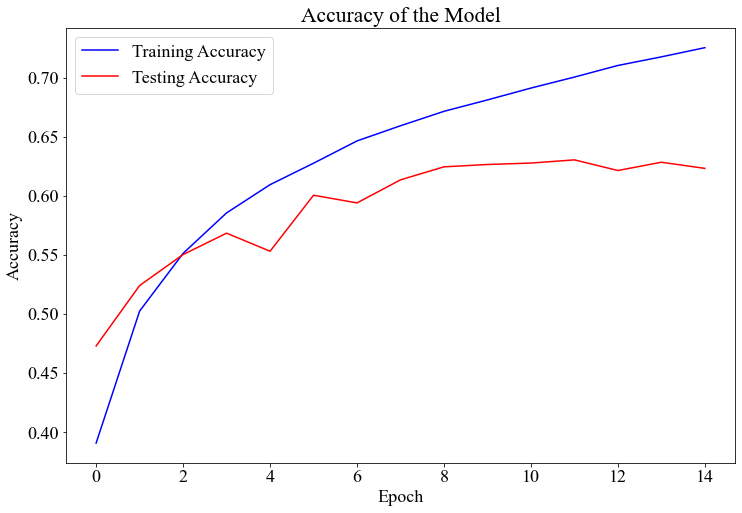

In [81]:
# Seting figure size:
plt.figure(figsize=(12,8))
plt.plot(train_history.history['accuracy'], "-b", label = "Training Accuracy")
plt.plot(train_history.history['val_accuracy'], "-r", label = "Testing Accuracy")
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend()
plt.title('Accuracy of the Model')
plt.show()

In [82]:
Y2_test_hat = model2.predict(X2_test)
y2_test_hat = Y2_test_hat.argmax(axis =- 1)

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


In [83]:
# Finding indices with wrong predictions
arrnotequal2 = np.not_equal(y2_test[:,0],y2_test_hat) 

In [84]:
# Extracting indices with wrong predictions
wrong_predictions_idx2 = [i for i, x in enumerate(arrnotequal2) if x]
wrong_predictions_im2 = Y2_test_hat[arrnotequal2 == True]

In [85]:
print('The Overall Accuracy Percentage is:')
print(100 * (len(y2_test) - len(wrong_predictions_im2)) / len(y2_test))

The Overall Accuracy Percentage is:
62.32


### <span style='font-family:"Times New Roman"'> <span styel=''>(d-iii) Text summaries of the CIFAR10 LeNet architecture:

In [86]:
print_params(model2)


The Layer 0 Features are :
Layer Name: conv2d_6
Layer Type: Conv2D
Trainable : Yes
Filter Shape is : (5, 5, 3, 6)
Number of Biases : 6
Number of Weights : 5
Number of Parameters is : 456
Number of Total Trainable Parameters : 456
Number of Total Untrainable Parameters : 0

The Layer 1 Features are :
Layer Name: max_pooling2d_6
Layer Type: MaxPooling2D

The Layer 2 Features are :
Layer Name: conv2d_7
Layer Type: Conv2D
Trainable : Yes
Filter Shape is : (5, 5, 6, 12)
Number of Biases : 12
Number of Weights : 5
Number of Parameters is : 1812
Number of Total Trainable Parameters : 1812
Number of Total Untrainable Parameters : 0

The Layer 3 Features are :
Layer Name: max_pooling2d_7
Layer Type: MaxPooling2D

The Layer 4 Features are :
Layer Name: flatten_3
Layer Type: Flatten

The Layer 5 Features are :
Layer Name: dense_6
Layer Type: Dense
Trainable : Yes
Filter Shape is : (300, 192)
Number of Biases : 192
Number of Weights : 300
Number of Parameters is : 57792
Number of Total Trainable 

In [87]:
print_shapes(model2)


The Layer 0 Features are :
Layer Name: conv2d_6
Layer Type: Conv2D
Input Shape: (None, 32, 32, 3)
Output Shape: (None, 28, 28, 6)
Trainable : Yes

The Layer 1 Features are :
Layer Name: max_pooling2d_6
Layer Type: MaxPooling2D
Input Shape: (None, 28, 28, 6)
Output Shape: (None, 14, 14, 6)
Trainable : No

The Layer 2 Features are :
Layer Name: conv2d_7
Layer Type: Conv2D
Input Shape: (None, 14, 14, 6)
Output Shape: (None, 10, 10, 12)
Trainable : Yes

The Layer 3 Features are :
Layer Name: max_pooling2d_7
Layer Type: MaxPooling2D
Input Shape: (None, 10, 10, 12)
Output Shape: (None, 5, 5, 12)
Trainable : No

The Layer 4 Features are :
Layer Name: flatten_3
Layer Type: Flatten
Input Shape: (None, 5, 5, 12)
Output Shape: (None, 300)
Trainable : No

The Layer 5 Features are :
Layer Name: dense_6
Layer Type: Dense
Input Shape: (None, 300)
Output Shape: (None, 192)
Trainable : Yes

The Layer 6 Features are :
Layer Name: dense_7
Layer Type: Dense
Input Shape: (None, 192)
Output Shape: (None, 1

#### <span style='font-family:"Times New Roman"'> <span styel=''>The number of layers is the same as network trained on MNIST dataset. However, since the shape of the CIFAR10 input is different than MNIST (3 channel with 32 by 32 size), the number of parameter and consequently, number of trained parameters are larger. 

### <span style='font-family:"Times New Roman"'> <span styel=''> (d-iv) Activations of the CIFAR10 LeNet architecture:

In [88]:
X2_example = X2_test[0]
X2_example = np.reshape(X2_example,((1,32, 32, 3)))

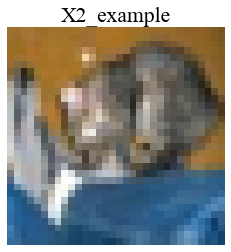

In [89]:
plt.imshow(X2_example[0,:,:,:])
plt.axis('off')
plt.title('X2_example')
plt.show()

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


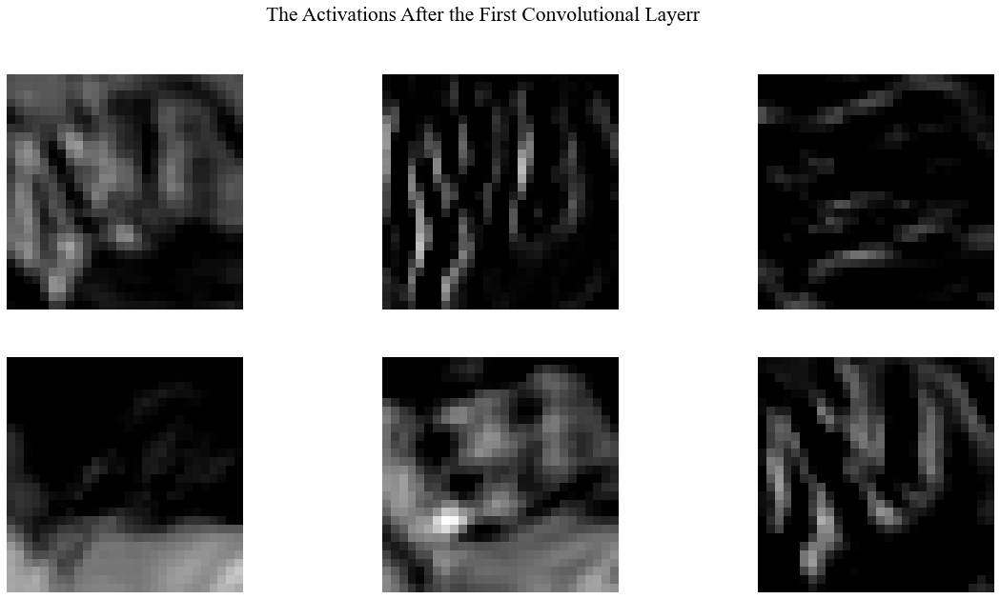

In [90]:
model2_layeri = tf.keras.models.Model(inputs = model2.inputs, outputs = model2.layers[0].output)
layeri_acts = model2_layeri.predict(X2_example);
nrows, ncols = 2 , 3
plt.figure(figsize=(20,10))
k = 1
for i in range(layeri_acts.shape[3]):
    plt.subplot(nrows, ncols, k)
    plt.imshow(layeri_acts[0,:,:,i], cmap = 'gray', vmin = np.min(layeri_acts) , vmax = np.max(layeri_acts))
    plt.axis('off')
    k += 1
plt.suptitle('The Activations After the First Convolutional Layerr')
plt.show()

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


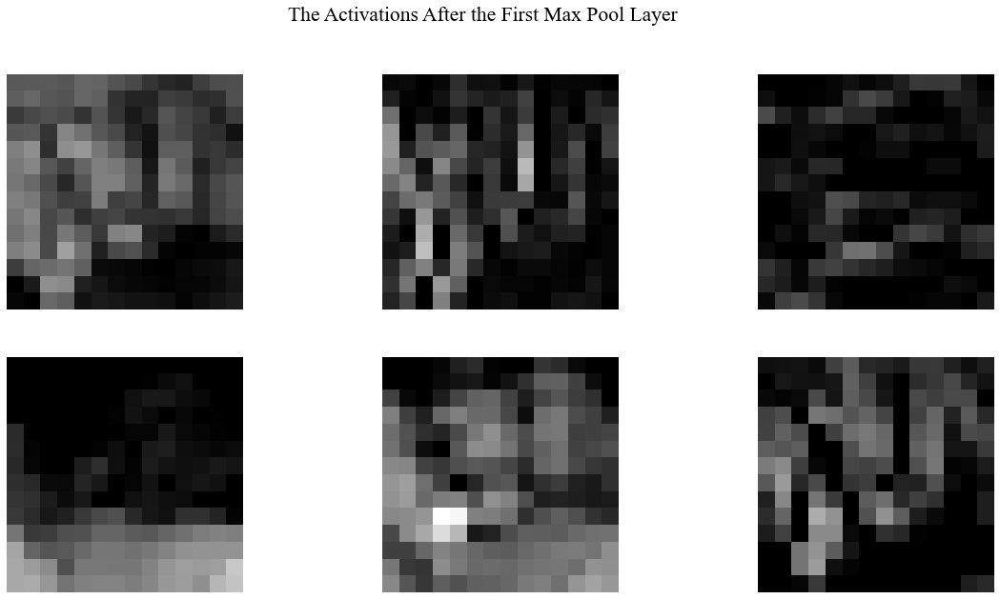

In [91]:
model2_layeri = tf.keras.models.Model(inputs = model2.inputs, outputs = model2.layers[1].output)
layeri_acts = model2_layeri.predict(X2_example);
nrows, ncols = 2 , 3
plt.figure(figsize=(20,10))
k = 1
for i in range(layeri_acts.shape[3]):
    plt.subplot(nrows, ncols, k)
    plt.imshow(layeri_acts[0,:,:,i], cmap = 'gray', vmin = np.min(layeri_acts) , vmax = np.max(layeri_acts))
    plt.axis('off')
    k += 1
plt.suptitle('The Activations After the First Max Pool Layer')
plt.show()

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


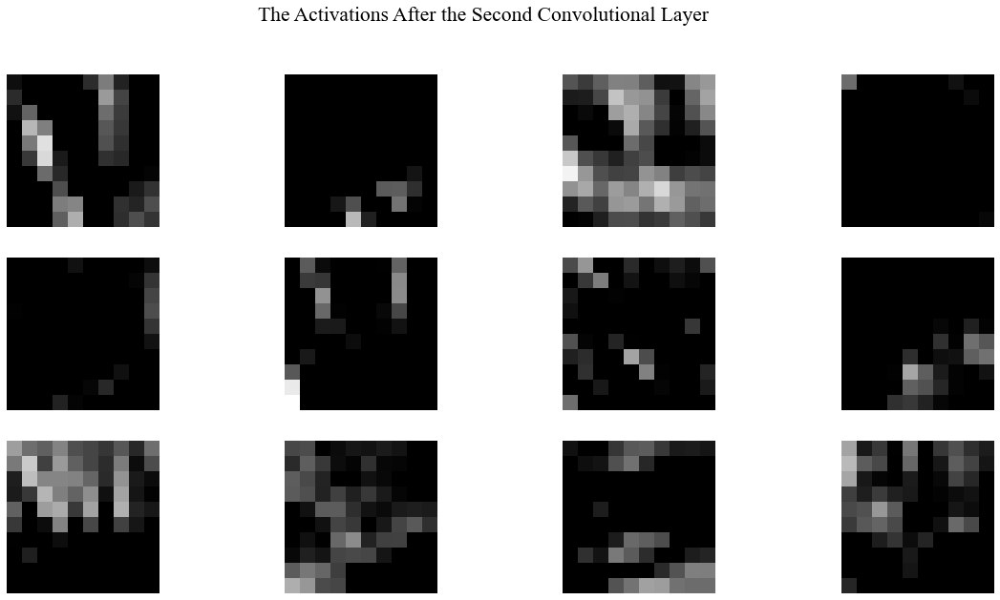

In [92]:
model2_layeri = tf.keras.models.Model(inputs = model2.inputs, outputs = model2.layers[2].output)
layeri_acts = model2_layeri.predict(X2_example);
nrows, ncols = 3 , 4
plt.figure(figsize=(20,10))
k = 1
for i in range(layeri_acts.shape[3]):
    plt.subplot(nrows, ncols, k)
    plt.imshow(layeri_acts[0,:,:,i], cmap = 'gray', vmin = np.min(layeri_acts) , vmax = np.max(layeri_acts))
    plt.axis('off')
    k += 1
plt.suptitle('The Activations After the Second Convolutional Layer')
plt.show()

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


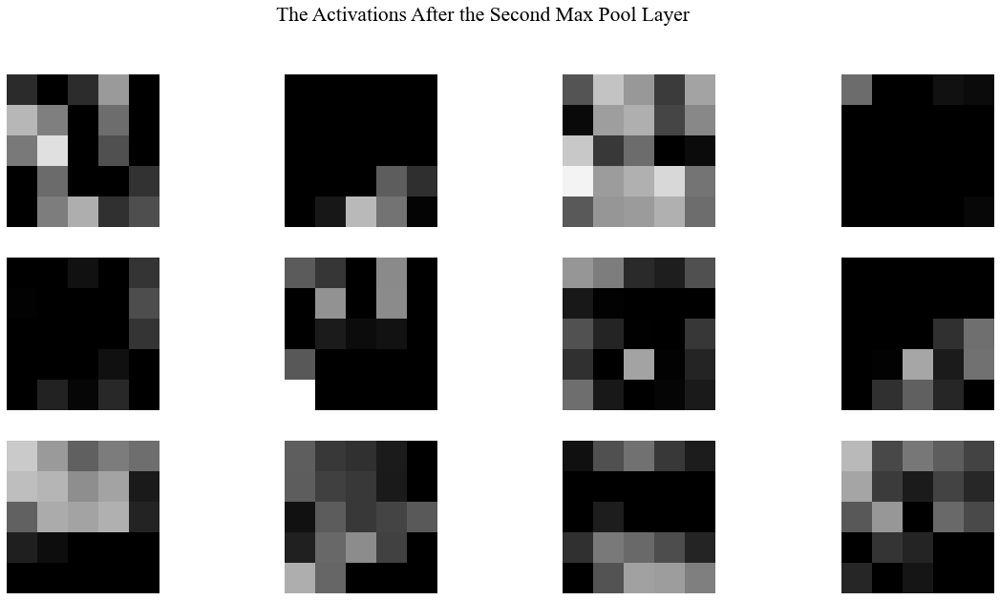

In [93]:
model2_layeri = tf.keras.models.Model(inputs = model2.inputs, outputs = model2.layers[3].output)
layeri_acts = model2_layeri.predict(X2_example);
nrows, ncols = 3 , 4
plt.figure(figsize=(20,10))
k = 1
for i in range(layeri_acts.shape[3]):
    plt.subplot(nrows, ncols, k)
    plt.imshow(layeri_acts[0,:,:,i], cmap = 'gray', vmin = np.min(layeri_acts) , vmax = np.max(layeri_acts))
    plt.axis('off')
    k += 1
plt.suptitle('The Activations After the Second Max Pool Layer')
plt.show()

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


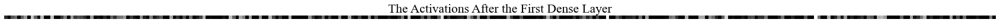

In [94]:
model2_layeri = tf.keras.models.Model(inputs = model2.inputs, outputs = model2.layers[4].output)
layeri_acts = model2_layeri.predict(X2_example);
plt.figure(figsize=(30,2))
plt.imshow(layeri_acts, cmap = 'gray', vmin = np.min(layeri_acts) , vmax = np.max(layeri_acts))
plt.axis('off')
plt.title('The Activations After the First Dense Layer')
plt.show()

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


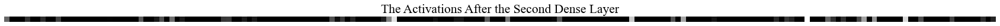

In [95]:
model2_layeri = tf.keras.models.Model(inputs = model2.inputs, outputs = model2.layers[5].output)
layeri_acts = model2_layeri.predict(X2_example);
plt.figure(figsize=(30,2))
plt.imshow(layeri_acts, cmap = 'gray', vmin = np.min(layeri_acts) , vmax = np.max(layeri_acts))
plt.axis('off')
plt.title('The Activations After the Second Dense Layer')
plt.show()

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


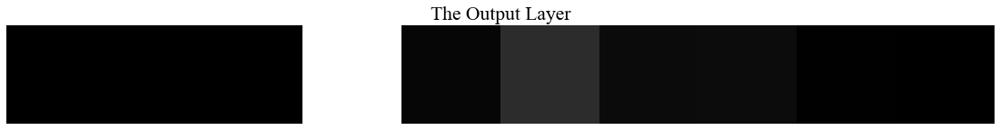

In [96]:
model2_layeri = tf.keras.models.Model(inputs = model2.inputs, outputs = model2.layers[6].output)
layeri_acts = model2_layeri.predict(X2_example);
plt.figure(figsize=(30,2))
plt.imshow(layeri_acts, cmap = 'gray', vmin = np.min(layeri_acts) , vmax = np.max(layeri_acts))
plt.axis('off')
plt.title('The Output Layer')
plt.show()

#### <span style='font-family:"Times New Roman"'> <span styel=''> The activations get abstract as we move forward in our network which was expected. The image apparently belongs to cat category. Also, the image is in such a poor quality that the main image does not look like a cat. Hence, the activations do not seem to detect any reasonable edges or objects which we can relate to cats. And as we move forward, the activations become more abstract and reasonable guess about what features they are sensitive to is not possible . 

### <span style='font-family:"Times New Roman"'> <span styel=''>(d-v) Confusion matrix for the CIFAR10 LeNet architecture:

In [97]:
# Calculating Confusion Matrix
category_filenames = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Ctest = sklearn.metrics.confusion_matrix(y2_test, y2_test_hat, labels = category_filenames)
print('Confusion Matrix for all dataset for classifier is: ')
print(Ctest)

Confusion Matrix for all dataset for classifier is: 
[[652  16  65  22  59  16  18  25  85  42]
 [ 15 641  15  17  15  13  30  21  39 194]
 [ 51   4 447  64 165 100  94  40  25  10]
 [ 11   4  64 374 132 196 120  60  16  23]
 [ 16   2  61  40 669  45  87  60  12   8]
 [  7   4  49 151  91 550  67  65   4  12]
 [  4   2  39  48 100  37 749  10   3   8]
 [  6   2  25  31 128  86  20 679   6  17]
 [ 72  31  23  21  28  19  17  12 743  34]
 [ 34  57  13  25  29  18  28  39  29 728]]


In [98]:
Ctest = Ctest/Ctest.sum(axis=1)[:,None]

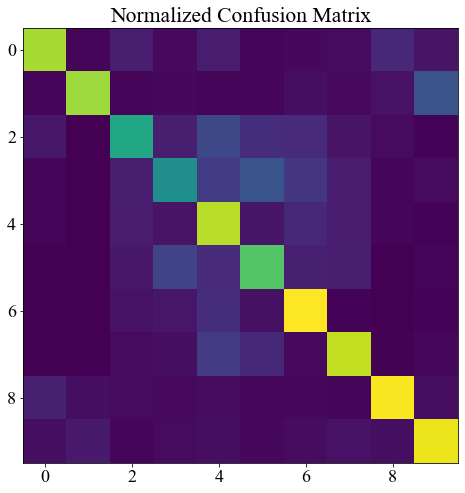

In [99]:
plt.figure(figsize=(8,8))
plt.imshow(Ctest)
plt.title('Normalized Confusion Matrix')
plt.show()

In [100]:
Y2_train_hat = model2.predict(X2_train)
y2_train_hat = Y2_train_hat.argmax(axis =- 1)

In [101]:
Ctrain = sklearn.metrics.confusion_matrix(y2_train, y2_train_hat, labels = category_filenames)
Ctrain = Ctrain/Ctrain.sum(axis=1)[:,None]

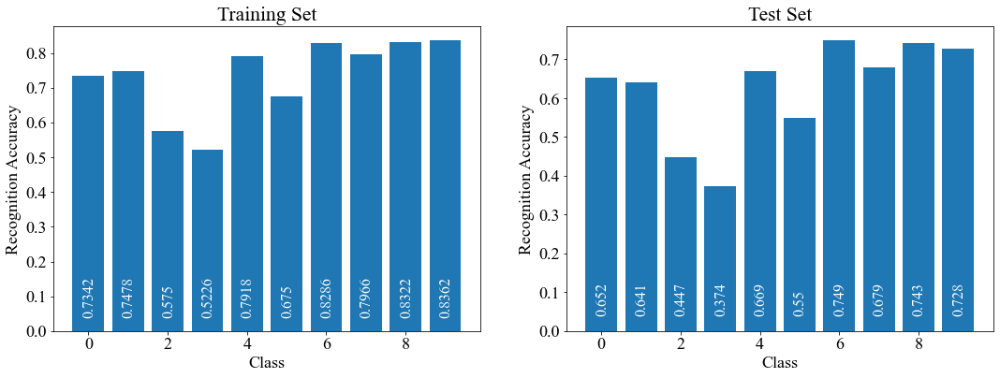

In [102]:
plt.figure(figsize=(18,6))
plt.subplot(1, 2, 1)
plt.bar(category_filenames, Ctrain.diagonal())
xlocs, xlabs = plt.xticks()
xlocs = [i+1 for i in range(0,10)]
for i, v in enumerate(Ctrain.diagonal()):
    plt.text(i-0.17, 
              0.05, 
              Ctrain.diagonal()[i],
              rotation=90,
              fontsize=16,
              color = 'White',
             )
plt.xlabel('Class')
plt.ylabel('Recognition Accuracy') 
plt.title('Training Set')
plt.subplot(1, 2, 2)
plt.bar(category_filenames, Ctest.diagonal())
xlocs, xlabs = plt.xticks()
xlocs = [i+1 for i in range(0,10)]
for i, v in enumerate(Ctest.diagonal()):
    plt.text(i-0.17, 
              0.05, 
              Ctest.diagonal()[i],
              rotation=90,
              fontsize=16,
              color = 'White',
             )
plt.xlabel('Class')
plt.ylabel('Recognition Accuracy') 
plt.title('Test Set')
plt.show()

#### <span style='font-family:"Times New Roman"'> <span styel=''>The lowest accuracy belongs to label 3 (cats) and best accuracy belongs to label 8 (ships). Overall, since extracted features from animal group could be similar and we have large group of them in our dataset, the misclassification is severe among them. The extracted features for instance between dogs and cats could be so similar that severe misclassification is happening.  While misclassification is less noticeable among cars, ships and trucks. 

## <span style='font-family:"Times New Roman"'> <span styel=''> (e) (Graduate Only) Train a CNN on CalTech101.

#### <span style='font-family:"Times New Roman"'> <span styel=''>In this part, we train a CNN using CalTech101 (http://www.vision.caltech.edu/Image_Datasets/Caltech101/) dataset. 

In [103]:
categories_directory = sorted(glob.glob('101_ObjectCategories/*'))
image_directory = '101_ObjectCategories'

In [104]:
#Sorting categories file names
my_category = sorted(glob.glob(image_directory + '\\*'))
#Saving category file names inside a list
category_filenames = []
for i in range(len(my_category)):
    category_filenames.append(my_category[i][21:])

y3_train = []
y3_test = []
x3_train = []
x3_test = []
mylabel = []

#Adding 90 percent of data to our traning dataset  
#Adding 10 percent of data to our testing dataset 
for f, category_name in enumerate(category_filenames):
    imagenames = sorted(glob.glob(image_directory + '\\' + category_filenames[f] +'\\*'))
    mylabel.append([str(f)] * len(imagenames))
    x3_train.extend(imagenames[0 : np.floor(0.9 * len(imagenames)).astype(int)])
    x3_test.extend(imagenames[np.floor(0.9 * len(imagenames)).astype(int) : len(imagenames) + 1])
    y3_train.extend(mylabel[f][0 : np.floor(0.9 * len(imagenames)).astype(int)])
    y3_test.extend(mylabel[f][np.floor(0.9 * len(imagenames)).astype(int) : len(imagenames)+1])

#### <span style='font-family:"Times New Roman"'> <span styel=''>The CalTech101 dataset images are from different shapes. So, in this section, I decided to resize the images to 100 by 200 by 3. Resizing image is a reasonable action to take when dealing with ununiform dataset. The code is written in a way that if there is a grayscale image, it will convert the grayscale image RGB. 

In [105]:
def imagerescale(image):
    # Reading image as numpy array 
    im = plt.imread(image)
    # Checking RGB condition 
    if(len(im.shape)<3):
        #Converting Grayscale to RGB
        im = skimage.color.gray2rgb(im)
    # Resizing the image to 100*200*3
    im = skimage.transform.resize(im, (100,200,3))
    return im

In [106]:
# zero numpy arrays for faster implementation 
X3_train = np.zeros((len(y3_train),100,200,3))
X3_test = np.zeros((len(y3_test),100,200,3))

In [107]:
for i in range(len(y3_train)):
    X3_train[i,:,:,:] = imagerescale(x3_train[i])
for j in range(len(y3_test)):
    X3_test[j,:,:,:] = imagerescale(x3_test[j])

In [108]:
# one-hot coding procedure for CalTech101 labels
y3_train = np.array(y3_train)
y3_test = np.array(y3_test)
y3_train1 = y3_train.astype(np.uint8)
y3_test1 = y3_test.astype(np.uint8)
y3_train = to_categorical(y3_train1)
y3_test = to_categorical(y3_test1)

#### <span style='font-family:"Times New Roman"'> <span styel=''>Since dataset is small, reaching good accuracy would be difficult. Hence, a deeper network compared to last parts is selected. 2 convolutional layers with 16 and 32 neurons, a max pool layer, and 2 more convolutional layers with 64 and 128 neurons are added to model.      

In [109]:
# Sequential groups a linear stack of layers into a tf.keras.Model
model3 = tf.keras.models.Sequential()
# Adding Convolution Layer
model3.add(tf.keras.layers.Convolution2D(16,(3,3), activation='relu', input_shape = (100,200,3), data_format = 'channels_last'))
# Adding Convolution Layer
model3.add(tf.keras.layers.Convolution2D(32,(3,3), activation='relu', data_format = 'channels_last'))
# Max Pooling Layer
model3.add(tf.keras.layers.MaxPooling2D(pool_size=(2,2), data_format = 'channels_last'))
# Adding Convolution Layer
model3.add(tf.keras.layers.Convolution2D(64,(3,3), activation='relu', data_format = 'channels_last'))
# Adding Convolution Layer
model3.add(tf.keras.layers.Convolution2D(128,(3,3), activation='relu', data_format = 'channels_last'))
# Max Pooling Layer
model3.add(tf.keras.layers.MaxPooling2D(pool_size=(2,2), data_format = 'channels_last'))
model3.add(tf.keras.layers.Flatten())
# Output Layer with 10 outputs and softmax activation function
model3.add(tf.keras.layers.Dense(101, activation='softmax'))
model3.summary()

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_8 (Conv2D)            (None, 98, 198, 16)       448       
_________________________________________________________________
conv2d_9 (Conv2D)            (None, 96, 196, 32)       4640      
_________________________________________________________________
max_pooling2d_8 (MaxPooling2 (None, 48, 98, 32)        0         
_________________________________________________________________
conv2d_10 (Conv2D)           (None, 46, 96, 64)        18496     
_________________________________________________________________
conv2d_11 (Conv2D)           (None, 44, 94, 128)       73856     
_________________________________________________________________
max_pooling2d_9 (MaxPooling2 (None, 22, 47, 128)       0         
_________________________________________________________________
flatten_4 (Flatten)          (None, 132352)           

In [110]:
model3.compile(loss = 'categorical_crossentropy', optimizer = 'adam', metrics = ['accuracy'])

In [111]:
start_time = time.time() #For run time calculation
train_history = model3.fit(X3_train, y3_train, batch_size = 64, epochs = 30, verbose = 1, validation_data = (X3_test, y3_test))
Elapsed_Time = time.time() - start_time

Epoch 1/30
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
122/122 [==============================] - ETA: 0s - loss: 3.2253 - accuracy: 0.3434WARNING:tensorflow:AutoGraph could not transform <function Model.make_test_function.<locals>.test_function at 0x0000020215EBC1F8> and will run it as-is.
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`

In [112]:
print('Training time in minutes is :')
print(Elapsed_Time/60)

Training time in minutes is :
13.96299368540446


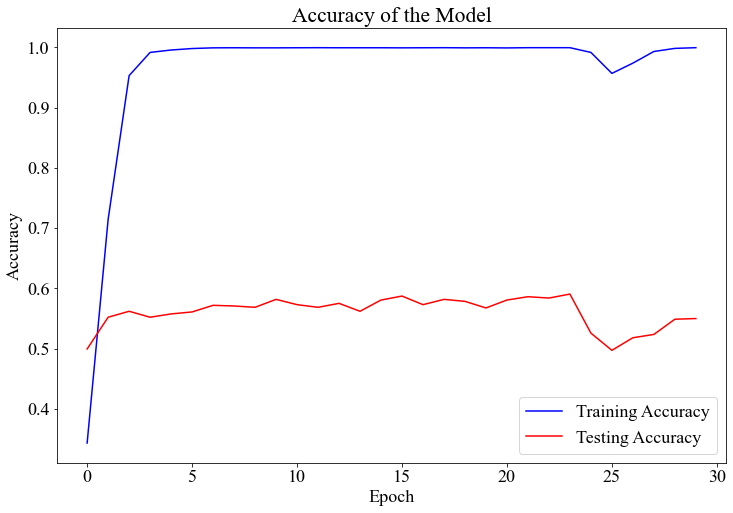

In [113]:
# Seting figure size:
plt.figure(figsize=(12,8))
plt.plot(train_history.history['accuracy'], "-b", label = "Training Accuracy")
plt.plot(train_history.history['val_accuracy'], "-r", label = "Testing Accuracy")
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend()
plt.title('Accuracy of the Model')
plt.show()

#### <span style='font-family:"Times New Roman"'> <span styel=''> As it can seen from training accuracy and validation accuracy, over fitting is happening since the dataset is small and our network is big (accuracy: 0.9994 and validation accuracy: 0.5829). There are methods to avoid overfitting which we are not discussing them in this project. 

In [114]:
Y3_test_hat = model3.predict(X3_test)
y3_test_hat = Y3_test_hat.argmax(axis =- 1)

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


In [115]:
# Finding indices with wrong predictions
arrnotequal3 = np.not_equal(y3_test1,y3_test_hat) 

In [116]:
# Extracting indices with wrong predictions
wrong_predictions_idx3 = [i for i, x in enumerate(arrnotequal3) if x]
wrong_predictions_im3 = Y3_test_hat[arrnotequal3 == True]

In [117]:
print('The Overall Accuracy Percentage is:')
print(100 * (len(y3_test1) - len(wrong_predictions_im3)) / len(y3_test1))

The Overall Accuracy Percentage is:
54.99451152579583


#### <span style='font-family:"Times New Roman"'> <span styel=''> We reached a testing accuracy of 58.29 percent without any feature extraction. It is almost close to SVM performance which was 62 percent in last project with 92 features extracted from images and used for classification.  

In [118]:
# Calculating Confusion Matrix
C = sklearn.metrics.confusion_matrix(y3_test1, y3_test_hat, labels =  np.linspace(0, 100, num=101))
print('Confusion Matrix for all dataset for classifier is: ')
print(C)

Confusion Matrix for all dataset for classifier is: 
[[40  0  0 ...  0  0  0]
 [ 0 44  0 ...  0  0  0]
 [ 1  0 15 ...  0  0  0]
 ...
 [ 0  0  0 ...  2  0  0]
 [ 0  0  0 ...  0  0  0]
 [ 0  0  0 ...  0  0  5]]


In [119]:
C = C/C.sum(axis=1)[:,None]

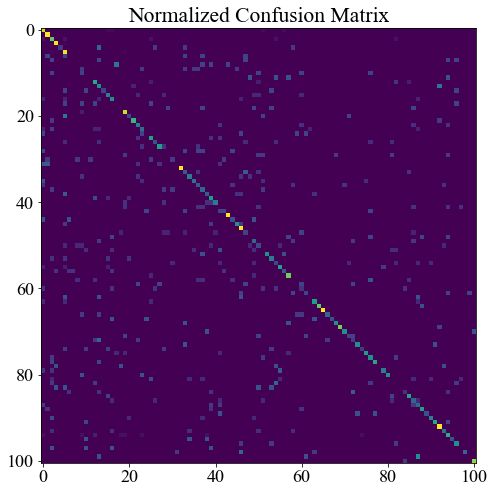

In [120]:
C = C/C.sum(axis=1)[:,None]
plt.figure(figsize=(8,8))
plt.imshow(C)
plt.title('Normalized Confusion Matrix')
plt.show()

In [121]:
for j in range (len(C)):
    print('')
    print('Accuracy of classification for ' + str(category_filenames[j]) + ' category is :')
    print(C[j,j]*100)      
    idx = np.where(C[j,:] != 0)[0]
    idx = np.delete(idx, np.where(idx == j))
    print('')
    print('misclassified as')
    for i in range (len(idx)):
        print(str(category_filenames[idx[i]]))
        print(C[j,idx[i]] * 100)


Accuracy of classification for Faces category is :
90.90909090909092

misclassified as
buddha
2.272727272727273
butterfly
2.272727272727273
ibis
2.272727272727273
lamp
2.272727272727273

Accuracy of classification for Faces_easy category is :
100.0

misclassified as

Accuracy of classification for Leopards category is :
75.0

misclassified as
Faces
5.0
airplanes
5.0
cougar_face
5.0
kangaroo
5.0
sea_horse
5.0

Accuracy of classification for Motorbikes category is :
98.75

misclassified as
airplanes
1.25

Accuracy of classification for accordion category is :
16.666666666666664

misclassified as
brain
33.33333333333333
crab
16.666666666666664
dolphin
16.666666666666664
llama
16.666666666666664

Accuracy of classification for airplanes category is :
97.5

misclassified as
Leopards
1.25
car_side
1.25

Accuracy of classification for anchor category is :
0.0

misclassified as
Faces_easy
20.0
airplanes
20.0
dolphin
20.0
emu
20.0
hawksbill
20.0

Accuracy of classification for ant category is 

#### <span style='font-family:"Times New Roman"'> <span styel=''>The SVM classifier did perfect job in some categories like (Faces_easy, Leopards, Motorbikes, and so on) while Trained CNN classifier here fails to do so but gives high accuracies although some weird misclassifications exist. Both classifiers struggle with some classes like ant which both resulted in 0 percent accuracy, barrel or anchor.  

## <span style='font-family:"Times New Roman"'> <span styel=''> (f) The VGG16 Network and Transfer Learning.

#### <span style='font-family:"Times New Roman"'> <span styel=''>  The VGG CNN architectures are some of the common “standard” CNN architectures for image classification. These architectures have additionally been pretrained on ImageNet. In this part, we will be using the VGG16 architecture. A handy list of the 1000 ImageNet classes can be found at https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a.

In [122]:
from keras.applications.vgg16 import preprocess_input
from keras.applications.vgg16 import decode_predictions
from keras.preprocessing.image import img_to_array
from keras.preprocessing.image import load_img
import keras.preprocessing
import keras.applications

### <span style='font-family:"Times New Roman"'> <span styel=''>(f-i) Text summaries of VGG16:

In [123]:
model4 = tf.keras.applications.vgg16.VGG16(include_top = True, weights = 'imagenet')

In [124]:
model4.summary()

Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0     

In [125]:
print_params(model4)


The Layer 0 Features are :
Layer Name: input_1
Layer Type: InputLayer

The Layer 1 Features are :
Layer Name: block1_conv1
Layer Type: Conv2D
Trainable : Yes
Filter Shape is : (3, 3, 3, 64)
Number of Biases : 64
Number of Weights : 3
Number of Parameters is : 1792
Number of Total Trainable Parameters : 1792
Number of Total Untrainable Parameters : 0

The Layer 2 Features are :
Layer Name: block1_conv2
Layer Type: Conv2D
Trainable : Yes
Filter Shape is : (3, 3, 64, 64)
Number of Biases : 64
Number of Weights : 3
Number of Parameters is : 36928
Number of Total Trainable Parameters : 36928
Number of Total Untrainable Parameters : 0

The Layer 3 Features are :
Layer Name: block1_pool
Layer Type: MaxPooling2D

The Layer 4 Features are :
Layer Name: block2_conv1
Layer Type: Conv2D
Trainable : Yes
Filter Shape is : (3, 3, 64, 128)
Number of Biases : 128
Number of Weights : 3
Number of Parameters is : 73856
Number of Total Trainable Parameters : 73856
Number of Total Untrainable Parameters : 

In [126]:
print_shapes(model4)


The Layer 0 Features are :
Layer Name: input_1
Layer Type: InputLayer
Input Shape: [(None, 224, 224, 3)]
Output Shape: [(None, 224, 224, 3)]
Trainable : No

The Layer 1 Features are :
Layer Name: block1_conv1
Layer Type: Conv2D
Input Shape: (None, 224, 224, 3)
Output Shape: (None, 224, 224, 64)
Trainable : Yes

The Layer 2 Features are :
Layer Name: block1_conv2
Layer Type: Conv2D
Input Shape: (None, 224, 224, 64)
Output Shape: (None, 224, 224, 64)
Trainable : Yes

The Layer 3 Features are :
Layer Name: block1_pool
Layer Type: MaxPooling2D
Input Shape: (None, 224, 224, 64)
Output Shape: (None, 112, 112, 64)
Trainable : No

The Layer 4 Features are :
Layer Name: block2_conv1
Layer Type: Conv2D
Input Shape: (None, 112, 112, 64)
Output Shape: (None, 112, 112, 128)
Trainable : Yes

The Layer 5 Features are :
Layer Name: block2_conv2
Layer Type: Conv2D
Input Shape: (None, 112, 112, 128)
Output Shape: (None, 112, 112, 128)
Trainable : Yes

The Layer 6 Features are :
Layer Name: block2_pool


#### <span style='font-family:"Times New Roman"'> <span styel=''>According to VGG16 text summaries, the network is much larger compared to LeNet. While VGG16 has 22 layers, LeNet has 6 layers only. Also the magnitude of parameters in VGG16 is much larger than LeNet architecture. Also, the number of convolutional layers in VGG16 (13 layers) is more than LeNet architectures (2 layers ).  

### <span style='font-family:"Times New Roman"'> <span styel=''>(f-ii) VGG16 performance on CalTech101:

#### <span style='font-family:"Times New Roman"'> <span styel=''> The classes specified when VGG16 was trained on ImageNet are not exactly the same classes as specified for the CalTech101 dataset. In this part, we use the first images from each category in CalTech101 dataset for classification means. 

In [127]:
#Sorting categories file names
my_category = sorted(glob.glob(image_directory + '\\*'))
firstimage = []
for f, category_name in enumerate(category_filenames):
    imagenames = sorted(glob.glob(image_directory + '\\' + category_filenames[f] +'\\*'))
    # Getting first images 
    firstimage.append(imagenames[0])

In [128]:
for i in range(len(firstimage)):
    imagef_array = load_img(firstimage[i], target_size=(224, 224))
    imagef_array = img_to_array(imagef_array)
    imagef_array = imagef_array.reshape((1, imagef_array.shape[0], imagef_array.shape[1], imagef_array.shape[2]))
    imagef_nparray = preprocess_input(imagef_array)
    # predict the probability across all output classes
    yhat = model4.predict(imagef_nparray)
    # convert the probabilities to class labels
    label = decode_predictions(yhat)
    # retrieve the most likely result, e.g. highest probability
    label = label[0][0]
    # print the classification
    print('')
    print(category_filenames[i] + ' classified as ' + '%s (%.2f%%)' % (label[1], label[2]*100))

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert

Faces classified as bookcase (7.25%)

Faces_easy classified as crossword_puzzle (4.60%)

Leopards classified as cheetah (99.82%)

Motorbikes classified as moped (24.60%)

accordion classified as accordion (97.53%)

airplanes classified as warplane (95.29%)

anchor classified as knot (23.92%)

ant classified as ant (59.44%)

barrel classified as barrel (50.63%)

bass classifi

#### <span style='font-family:"Times New Roman"'> <span styel=''>VGG trained on imagenet is doing a good job in classifying CalTech101 dataset. There are some classes that are absent in Imagenet dataset. For instance, faces, gramophone, etc. are absent in Imagenet. As a result, the probability of these classes classified as other categories are low. For other classes like leopard or cougar, since the network has seen them before, he confidence of classification is high. Also, there are some strange classification with higher probabilities too. For instance, flamingo classified as hook (54.23%) which does not make sense.     

### <span style='font-family:"Times New Roman"'> <span styel=''>(f-iii) VGG16 activations for CalTech101 image:

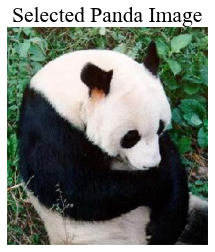

In [129]:
im = plt.imread('101_ObjectCategories\panda\image_0002.jpg')
plt.imshow(im )
plt.axis('off')
plt.title('Selected Panda Image')
plt.show()

In [130]:
# Preprocessing the image 
imagef_array = load_img('101_ObjectCategories\panda\image_0002.jpg', target_size=(224, 224))
imagef_array = img_to_array(imagef_array)
imagef_array = imagef_array.reshape((1, imagef_array.shape[0], imagef_array.shape[1], imagef_array.shape[2]))
imagef_nparray = preprocess_input(imagef_array)

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


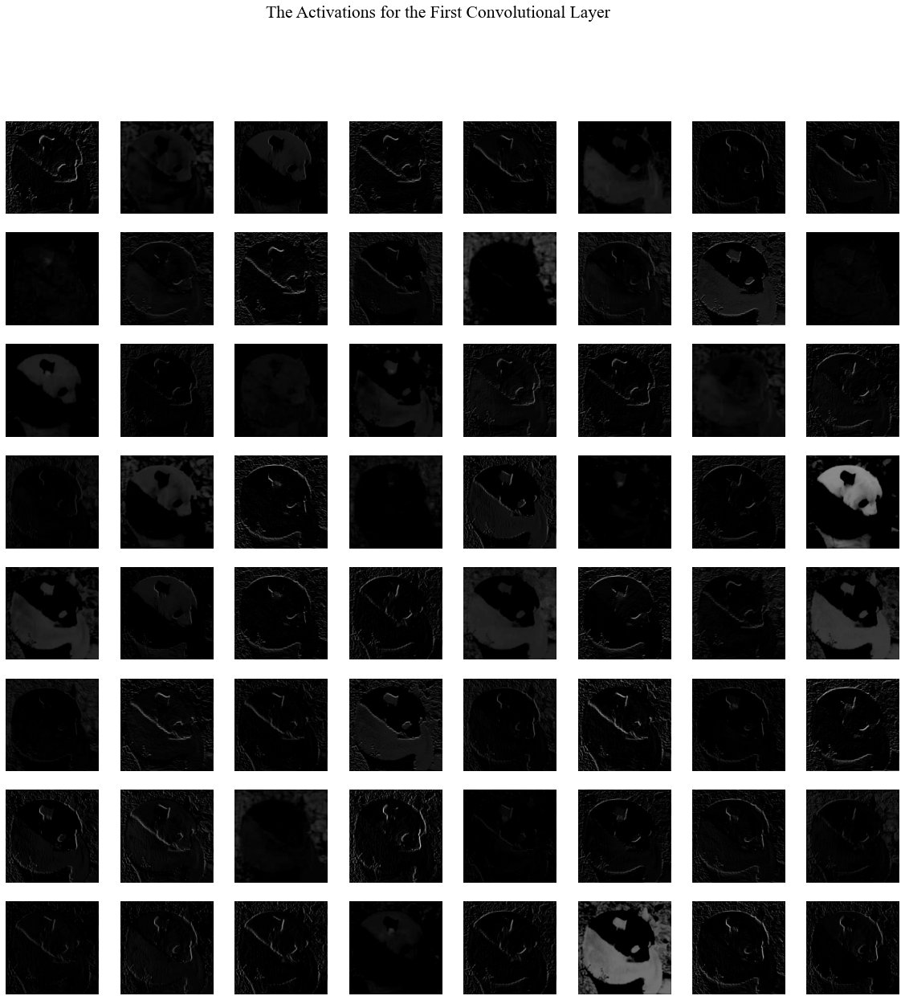

In [131]:
model4_layeri = tf.keras.models.Model(inputs = model4.inputs, outputs = model4.layers[1].output)
layeri_acts = model4_layeri.predict(imagef_nparray);
nrows, ncols = 8 , 8
plt.figure(figsize=(20,20))
k = 1
for i in range(layeri_acts.shape[3]):
    plt.subplot(nrows, ncols, k)
    plt.imshow(layeri_acts[0,:,:,i], cmap = 'gray', vmin = np.min(layeri_acts) , vmax = np.max(layeri_acts))
    plt.axis('off')
    k += 1
plt.suptitle('The Activations for the First Convolutional Layer')
plt.show()

#### <span style='font-family:"Times New Roman"'> <span styel=''> As expected, the activations at first convolutional layers are less abstract. The neurons seem to cue edges and colors in this layer. Even one of the neurons seem to cue on background information too.  

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


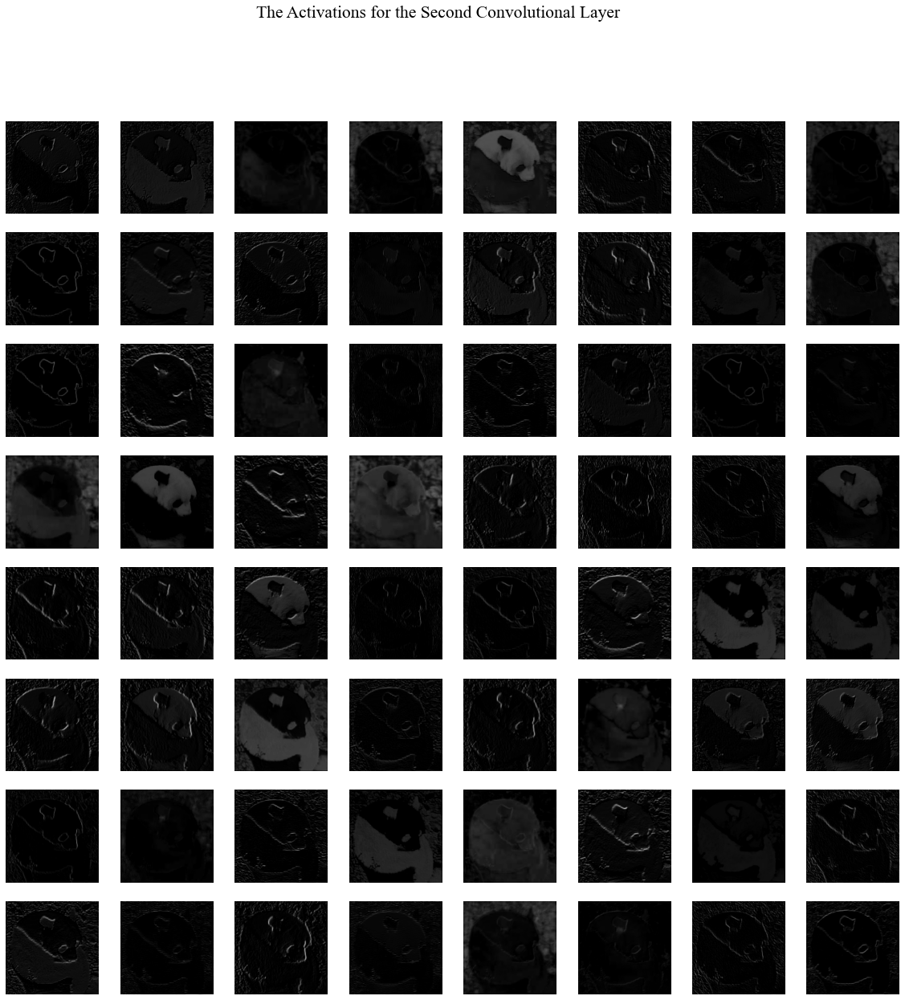

In [132]:
model4_layeri = tf.keras.models.Model(inputs = model4.inputs, outputs = model4.layers[2].output)
layeri_acts = model4_layeri.predict(imagef_nparray);
nrows, ncols = 8 , 8
plt.figure(figsize=(20,20))
k = 1
for i in range(layeri_acts.shape[3]):
    plt.subplot(nrows, ncols, k)
    plt.imshow(layeri_acts[0,:,:,i], cmap = 'gray', vmin = np.min(layeri_acts) , vmax = np.max(layeri_acts))
    plt.axis('off')
    k += 1
plt.suptitle('The Activations for the Second Convolutional Layer')
plt.show()

#### <span style='font-family:"Times New Roman"'>In second convolutional layer, more neurons are cue on background information of panda. Again edges are detected in this layer and color seem to be one other feature that neurons are detecting them.  

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


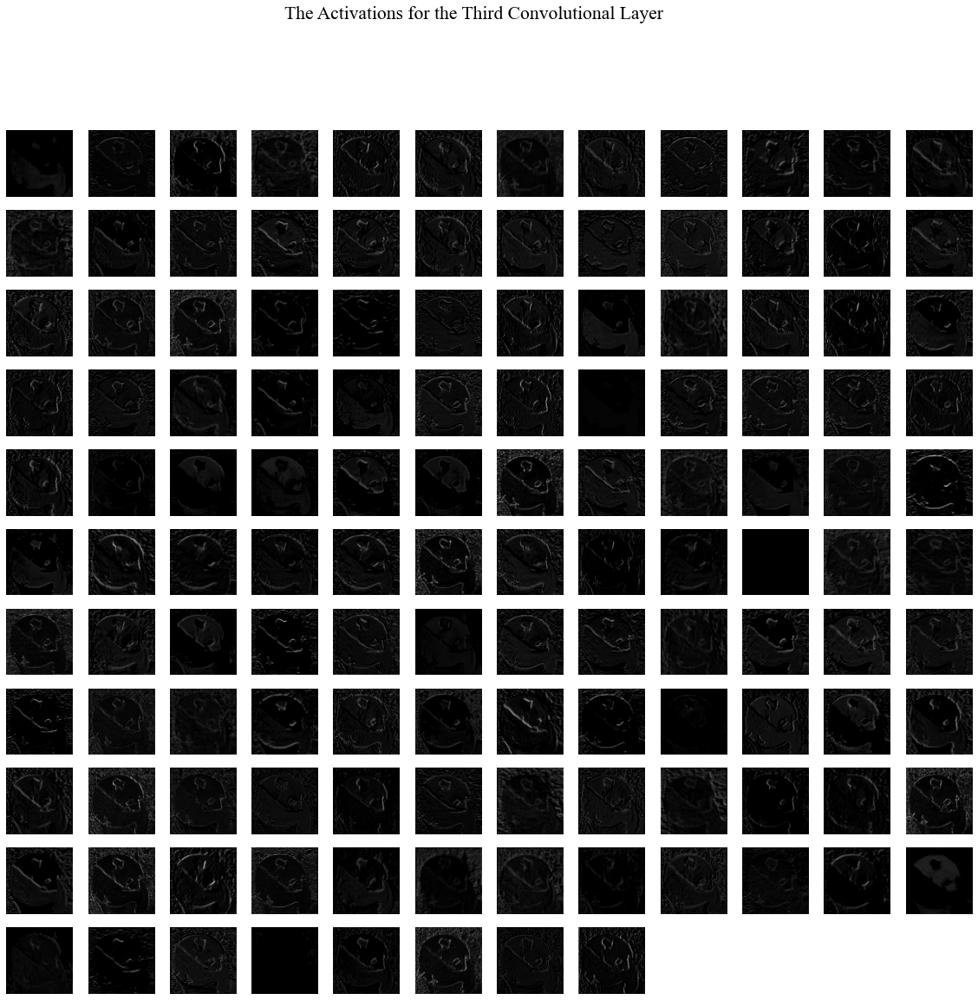

In [133]:
model4_layeri = tf.keras.models.Model(inputs = model4.inputs, outputs = model4.layers[4].output)
layeri_acts = model4_layeri.predict(imagef_nparray);
nrows, ncols = 12 , 12
plt.figure(figsize=(20,20))
k = 1
for i in range(layeri_acts.shape[3]):
    plt.subplot(nrows, ncols, k)
    plt.imshow(layeri_acts[0,:,:,i], cmap = 'gray', vmin = np.min(layeri_acts) , vmax = np.max(layeri_acts))
    plt.axis('off')
    k += 1
plt.suptitle('The Activations for the Third Convolutional Layer')
plt.show()

#### <span style='font-family:"Times New Roman"'> The activations in 3ed convolutional layer seem to be abstract compared the first two layers. Neurons are strongly cueing on edges and information about background of panda seems to be less important in this layer. The edges for eyes and ears of panda, its head can be seen here. Also, it seems like some neurons are ignoring information below pandas’ hand and consider its overall shape as circle. That is because of the difference of pandas’ hand colors.     

### <span style='font-family:"Times New Roman"'> <span styel=''>(f-iv) Transfer learning VGG16 for CalTech101:

#### <span style='font-family:"Times New Roman"'>In transfer learning, we “freeze” early layers in a network architecture that were already learned on another dataset and learn only the latter portion of it.

#### <span style='font-family:"Times New Roman"'>(1) Defining new output layer:

In [134]:
# take output just before classification layer
model4_tl = tf.keras.models.Model(inputs = model4.input, outputs = model4.layers[-2].output)
# take output as currently defined
new_output = model4_tl.output
# operate on that output with another dense layer
new_output = tf.keras.layers.Dense(101, activation='softmax')(new_output)
# define a new model with the new output
model4_tl = tf.keras.models.Model(inputs = model4_tl.input, outputs = new_output)

#### <span style='font-family:"Times New Roman"'>(2) Freezing convolutional layers:

In [135]:
for i in range (len(model4_tl.layers)):
        layer = model4_tl.layers[i]
        if 'conv' in layer.name:
            model4_tl.layers[i].trainable = False

In [136]:
print('Percentage of the total parameters that are trainable :')
print((count_params(model4_tl.trainable_weights) / model4_tl.count_params()) * 100)

Percentage of the total parameters that are trainable :
89.07387413909825


#### <span style='font-family:"Times New Roman"'>Since we freeze some layers, the number of trainable parameters has decreased.  

#### <span style='font-family:"Times New Roman"'> Creating CalTech101 training and test dataset directories:

In [137]:
categories_directory = sorted(glob.glob('101_ObjectCategories/*'))
image_directory = '101_ObjectCategories'

#Sorting categories file names
my_category = sorted(glob.glob(image_directory + '\\*'))
#Saving category file names inside a list
category_filenames = []
for i in range(len(my_category)):
    category_filenames.append(my_category[i][21:])

CalTech101_train = []
CalTech101_test = []
mylabel = []


for f, category_name in enumerate(category_filenames):
    imagenames = sorted(glob.glob(image_directory + '\\' + category_filenames[f] +'\\*'))
    mylabel.append([str(f)] * len(imagenames))
    CalTech101_train.extend(imagenames[0 : np.floor(0.9 * len(imagenames)).astype(int)])
    CalTech101_test.extend(imagenames[np.floor(0.9 * len(imagenames)).astype(int) : len(imagenames) + 1])

In [138]:
for j in range(len(CalTech101_train)):
    os.makedirs('CalTech101_train' + CalTech101_train[j][20:][:-14], exist_ok=True)
    shutil.copy2(CalTech101_train[j], 'CalTech101_train' + CalTech101_train[j][20:]) # complete target filename given

In [139]:
for j in range(len(CalTech101_test)):
    os.makedirs('CalTech101_test' + CalTech101_test[j][20:][:-14], exist_ok=True)
    shutil.copy2(CalTech101_test[j], 'CalTech101_test' + CalTech101_test[j][20:]) # complete target filename given

#### <span style='font-family:"Times New Roman"'> (4) Direct the network to the CalTech101 training dataset:

In [140]:
train_datagen = keras.preprocessing.image.ImageDataGenerator\
(preprocessing_function = keras.applications.vgg16.preprocess_input)
train_generator = train_datagen.flow_from_directory('CalTech101_train'\
                ,target_size=(224,244), color_mode = 'rgb', batch_size = 32, class_mode = 'categorical', shuffle=True)

Found 7766 images belonging to 101 classes.


In [141]:
test_datagen = keras.preprocessing.image.ImageDataGenerator\
(preprocessing_function = keras.applications.vgg16.preprocess_input)
test_generator = test_datagen.flow_from_directory('CalTech101_test'\
                ,target_size=(224,244), color_mode = 'rgb', batch_size = 32, class_mode = 'categorical', shuffle=False)

Found 911 images belonging to 101 classes.


#### <span style='font-family:"Times New Roman"'> (5) Specifying compiler options:

In [142]:
model4_tl.compile(loss='categorical_crossentropy', optimizer='adam',metrics=['accuracy'])

#### <span style='font-family:"Times New Roman"'> (6) Training:

#### <span style='font-family:"Times New Roman"'> 7 epochs have been selected for network convergence. This value has been selected using trial and error. Network seems to converge around 7 epochs and increasing number of epoch does not change the validation accuracy significantly.  

In [143]:
step_size_train = train_generator.n // train_generator.batch_size
step_size_test = test_generator.n // test_generator.batch_size
start_time = time.time() #For run time calculation
train_history_tl = model4_tl.fit_generator(generator = train_generator, steps_per_epoch = step_size_train, epochs = 7, verbose = 1, \
                        validation_data = test_generator, validation_steps = step_size_test)
Elapsed_Time = time.time() - start_time

Instructions for updating:
Please use Model.fit, which supports generators.
Epoch 1/7
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
242/242 [==============================] - ETA: 0s - loss: 2.1838 - accuracy: 0.7311WARNING:tensorflow:AutoGraph could not transform <function Model.make_test_function.<locals>.test_function at 0x000002021B116AF8> and will run it as-is.
Please report this to the TensorFlow team. When filing 

In [144]:
print('Training time in minutes is :')
print(Elapsed_Time/60)

Training time in minutes is :
14.557078369458516


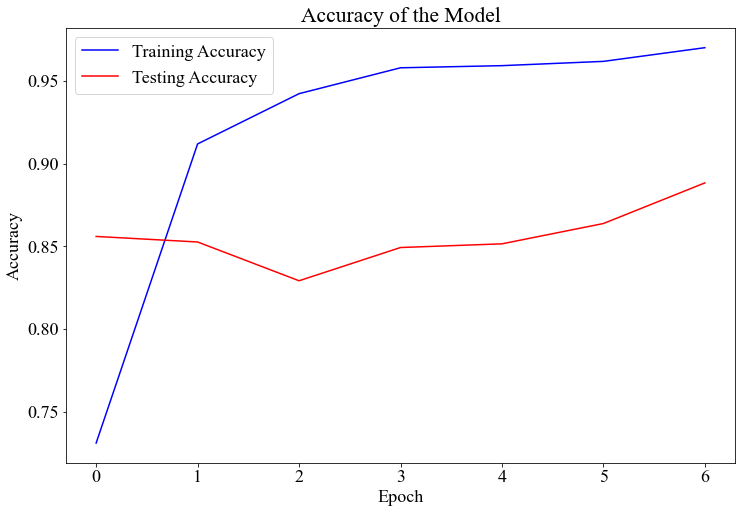

In [145]:
# Seting figure size:
plt.figure(figsize=(12,8))
plt.plot(train_history_tl.history['accuracy'], "-b", label = "Training Accuracy")
plt.plot(train_history_tl.history['val_accuracy'], "-r", label = "Testing Accuracy")
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend()
plt.title('Accuracy of the Model')
plt.show()

### <span style='font-family:"Times New Roman"'> <span styel=''>(f-v) Performance of Transfer learned VGG16 om CalTech101:

In [146]:
predict = model4_tl.predict_generator(test_generator, steps = 29)

Instructions for updating:
Please use Model.predict, which supports generators.
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


In [147]:
y_pred = np.argmax(predict, axis = 1)
C = sklearn.metrics.confusion_matrix(test_generator.classes, y_pred, labels =  np.linspace(0, 100, num = 101))
print('Confusion Matrix for test dataset for classifier is: ')
print(C)

Confusion Matrix for test dataset for classifier is: 
[[43  0  0 ...  0  0  0]
 [ 0 44  0 ...  0  0  0]
 [ 0  0 20 ...  0  0  0]
 ...
 [ 0  0  0 ...  5  0  0]
 [ 0  0  0 ...  0  2  0]
 [ 0  0  0 ...  0  0  6]]


In [148]:
acc = np.diag(C).sum().astype(float) / C.sum()
print('The accuracy for all dataset for classifier is: ')
print(acc)

The accuracy for all dataset for classifier is: 
0.8869374313940724


#### <span style='font-family:"Times New Roman"'> <span styel=''>The classifier did a tremendous job in classifying CalTech101 dataset reaching accuracy level of 86 percent. This is much better than SVM classified we did on the same dataset. 

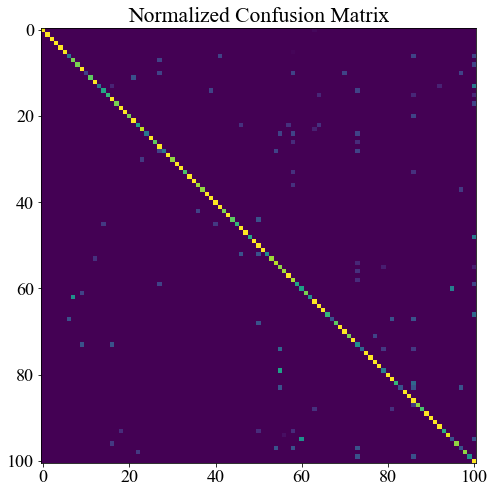

In [149]:
C = C/C.sum(axis=1)[:,None]
plt.figure(figsize=(8,8))
plt.imshow(C)
plt.title('Normalized Confusion Matrix')
plt.show()

In [150]:
for j in range (len(C)):
    print(' ')
    print('Accuracy of classification for ' + str(category_filenames[j]) + ' category is :')
    print(C[j,j]*100)  
    if C[j,j] == 1:
        continue 
    idx = np.where(C[j,:] != 0)[0]
    idx = np.delete(idx, np.where(idx == j))
    print('misclassified as')
    for i in range (len(idx)):
        print(str(category_filenames[idx[i]]))
        print(C[j,idx[i]] * 100)

 
Accuracy of classification for Faces category is :
97.72727272727273
misclassified as
menorah
2.272727272727273
 
Accuracy of classification for Faces_easy category is :
100.0
 
Accuracy of classification for Leopards category is :
100.0
 
Accuracy of classification for Motorbikes category is :
100.0
 
Accuracy of classification for accordion category is :
100.0
 
Accuracy of classification for airplanes category is :
98.75
misclassified as
llama
1.25
 
Accuracy of classification for anchor category is :
40.0
misclassified as
flamingo
20.0
starfish
20.0
yin_yang
20.0
 
Accuracy of classification for ant category is :
80.0
misclassified as
crayfish
20.0
 
Accuracy of classification for barrel category is :
80.0
misclassified as
yin_yang
20.0
 
Accuracy of classification for bass category is :
100.0
 
Accuracy of classification for beaver category is :
20.0
misclassified as
crayfish
20.0
llama
20.0
panda
20.0
wild_cat
20.0
 
Accuracy of classification for binocular category is :
75.0
m

#### <span style='font-family:"Times New Roman"'> <span styel=''> Although classifier reached higher accuracy, still there as some misclassifications that does not make sense like classifying anchor as brain or llama. On the other hand, some misclassifications make sense like classifying ant as lobster because they have same features and they look like each other. 

## <span style='font-family:"Times New Roman"'> <span styel=''> (g) (Graduate Only) Visualize Maximal Activations.

#### <span style='font-family:"Times New Roman"'> <span styel=''>In this part, we will explore visualizations of images that maximally activate a given neuron. If we use gradient ascent to generate an image that maximally activates a dense layer neuron, we will generate an image that is most class-like according to the network, e.g., the most flamingo-like image. If we generate an image that maximally activates a convolutional layer neuron, we will generate an image that is most featurelike according to the network, allowing us to explore what features each of the convolutional layer filters are cueing on.

In [1]:
import tf_keras_vis.activation_maximization
import tf_keras_vis.utils.callbacks
import matplotlib.pyplot as plt 
import tensorflow as tf
import numpy as np
import os

In [2]:
plt.rcParams["font.family"] = "Times New Roman"  # Setting Global Font to Times New Roman
plt.rcParams.update({'font.size': 18}) # Setting Global Font size

In [3]:
# Setting Global Path of Notebook to Avoid Hard-coding
notenookpath = os.path.abspath('') 
os.chdir(notenookpath)

### <span style='font-family:"Times New Roman"'> <span styel=''>(g-i) Maximal Activation for a Dense Layer Neuron:

#### <span style='font-family:"Times New Roman"'> <span styel=''> In this part, we visualize the maximal activation for a dense layer neuron. Since the last dense layer correspond to each of the 1000 ImageNet classes, this will visualize a class as “understood” by the VGG16 network.

In [4]:
model5 = tf.keras.applications.vgg16.VGG16(include_top = True, weights = 'imagenet')

In [5]:
def model_modifier(m):
    m.layers[-1].activation=tf.keras.activations.linear

In [6]:
model5_am = tf_keras_vis.activation_maximization.ActivationMaximization(model5, model_modifier, clone = True)

In [7]:
def loss(output):
    return output[:,cat_num]

In [8]:
cat_num = 130   #Flamingo
max_act = model5_am(loss,callbacks = [tf_keras_vis.utils.callbacks.Print(interval = 50)])

Steps: 050	Losses: [[121.10684967041016]],	Regularizations: [('TotalVariation', 79.4576416015625), ('L2Norm', 0.025653058663010597)]
Steps: 100	Losses: [[168.630615234375]],	Regularizations: [('TotalVariation', 85.68759155273438), ('L2Norm', 0.025572530925273895)]
Steps: 150	Losses: [[237.2529754638672]],	Regularizations: [('TotalVariation', 97.612060546875), ('L2Norm', 0.025462135672569275)]
Steps: 200	Losses: [[245.75775146484375]],	Regularizations: [('TotalVariation', 100.32057189941406), ('L2Norm', 0.025364886969327927)]


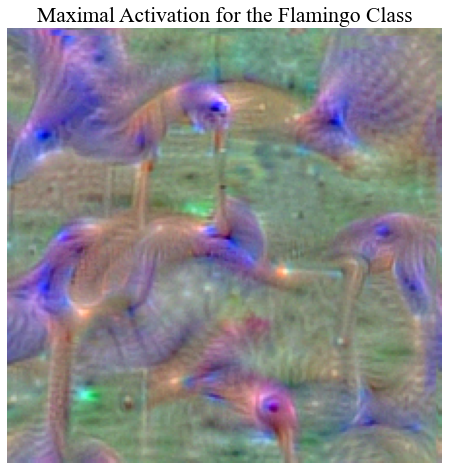

In [9]:
plt.figure(figsize=(8,8))
plt.imshow(max_act[0,:,:,:]/255)
plt.title('Maximal Activation for the Flamingo Class')
plt.axis('off')
plt.show()

#### <span style='font-family:"Times New Roman"'> <span styel=''> The image does not look like a flamingo at all but some parts of flamingo can be seen in the image like its bill (in one of them the flamingo is yelling :) ), eyes, and neck. 

In [10]:
cat_num = 372    #Baboon
max_act = model5_am(loss,callbacks = [tf_keras_vis.utils.callbacks.Print(interval = 50)])

Steps: 050	Losses: [[123.79825592041016]],	Regularizations: [('TotalVariation', 94.49832153320312), ('L2Norm', 0.0256497859954834)]
Steps: 100	Losses: [[184.0186004638672]],	Regularizations: [('TotalVariation', 92.2476577758789), ('L2Norm', 0.025551099330186844)]
Steps: 150	Losses: [[242.20433044433594]],	Regularizations: [('TotalVariation', 97.31462097167969), ('L2Norm', 0.02546849474310875)]
Steps: 200	Losses: [[269.9871520996094]],	Regularizations: [('TotalVariation', 102.3676986694336), ('L2Norm', 0.025388099253177643)]


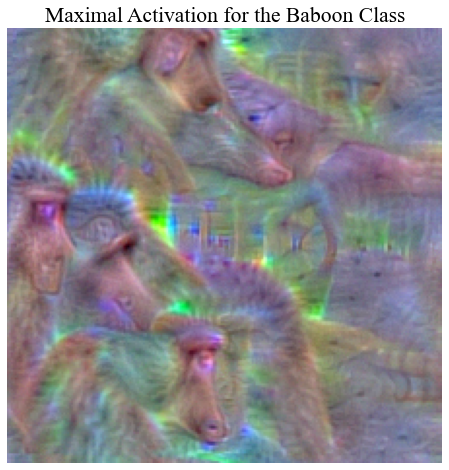

In [11]:
plt.figure(figsize=(8,8))
plt.imshow(max_act[0,:,:,:]/255)
plt.title('Maximal Activation for the Baboon Class')
plt.axis('off')
plt.show()

#### <span style='font-family:"Times New Roman"'> <span styel=''>  As the same discussion for flamingo, the maximal activation for baboon does not exactly look like a baboon but some features are clearly visible like boons face, and nose. Also, baboons body can be seen too.   

### <span style='font-family:"Times New Roman"'> <span styel=''>(g-ii) Maximal Activation for a Convolutional Layer Neuron:

#### <span style='font-family:"Times New Roman"'> <span styel=''>In this part, we visualize the maximal activation for a convolutional layer neuron. Since the convolutional layers are understood to be feature extractors, this will visualize an image that embodies the feature extracted by that neuron in the VGG16 network.

In [12]:
def model_modifier(current_model) :
    # using layer name
    target_layer = current_model.get_layer(name = layer_name)
    # using layer number
    #target_layer=current_model.get_layer(index=layer_idx)
    new_model = tf.keras.Model(inputs = current_model.inputs, outputs  = target_layer.output)
    new_model.layers[-1].activation = tf.keras.activations.linear
    return new_model

In [13]:
layer_name = 'block5_conv3'

In [14]:
model5_am = tf_keras_vis.activation_maximization.ActivationMaximization(model5, model_modifier, clone = True)

In [15]:
def loss(output):
    return output[..., filter_num]

In [16]:
filter_num = 42    
max_act = model5_am(loss,callbacks = [tf_keras_vis.utils.callbacks.Print(interval = 50)])

Steps: 050	Losses: [[178.0347900390625]],	Regularizations: [('TotalVariation', 93.48731231689453), ('L2Norm', 0.02560248412191868)]
Steps: 100	Losses: [[228.4242401123047]],	Regularizations: [('TotalVariation', 101.74993896484375), ('L2Norm', 0.025502949953079224)]
Steps: 150	Losses: [[254.52865600585938]],	Regularizations: [('TotalVariation', 103.44921112060547), ('L2Norm', 0.025393610820174217)]
Steps: 200	Losses: [[298.737060546875]],	Regularizations: [('TotalVariation', 111.92190551757812), ('L2Norm', 0.025257842615246773)]


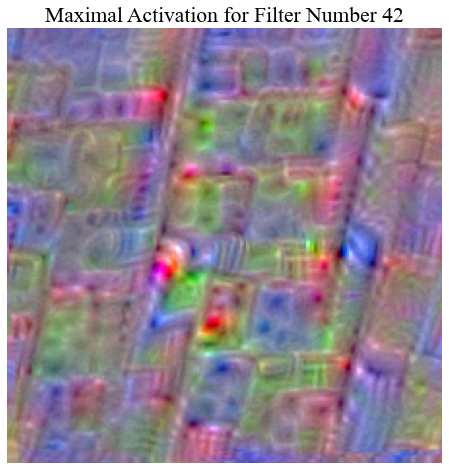

In [17]:
plt.figure(figsize=(8,8))
plt.imshow(max_act[0,:,:,:]/255)
plt.title('Maximal Activation for Filter Number 42')
plt.axis('off')
plt.show()

In [18]:
filter_num = 7 
max_act = model5_am(loss,callbacks = [tf_keras_vis.utils.callbacks.Print(interval = 50)])

Steps: 050	Losses: [[610.7119750976562]],	Regularizations: [('TotalVariation', 116.41624450683594), ('L2Norm', 0.025503935292363167)]
Steps: 100	Losses: [[924.5398559570312]],	Regularizations: [('TotalVariation', 131.4035186767578), ('L2Norm', 0.02531527355313301)]
Steps: 150	Losses: [[1146.0660400390625]],	Regularizations: [('TotalVariation', 162.21182250976562), ('L2Norm', 0.025136666372418404)]
Steps: 200	Losses: [[1223.343017578125]],	Regularizations: [('TotalVariation', 144.6788330078125), ('L2Norm', 0.02501343935728073)]


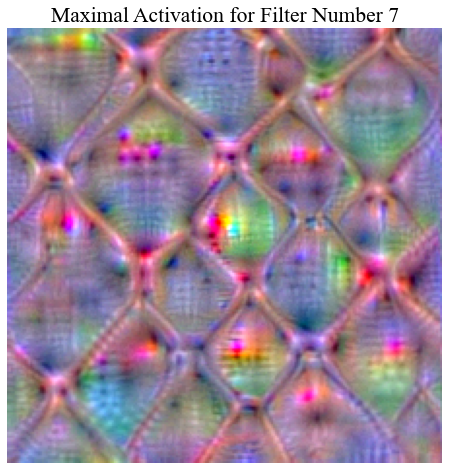

In [19]:
plt.figure(figsize=(8,8))
plt.imshow(max_act[0,:,:,:]/255)
plt.title('Maximal Activation for Filter Number 7')
plt.axis('off')
plt.show()

#### <span style='font-family:"Times New Roman"'> <span styel=''> The extracted features are so abstract that talking about them is almost impossible. It seems like these features belongs to texture of body part like skin.   

### <span style='font-family:"Times New Roman"'> <span styel=''>(g-iii) Maximal Activations for Multiple Classes:

In [1]:
import tf_keras_vis.activation_maximization
import tf_keras_vis.utils.callbacks
import matplotlib.pyplot as plt 
import tensorflow as tf
import numpy as np
import random
import os


plt.rcParams["font.family"] = "Times New Roman"  # Setting Global Font to Times New Roman
plt.rcParams.update({'font.size': 18}) # Setting Global Font size


# Setting Global Path of Notebook to Avoid Hard-coding
notenookpath = os.path.abspath('') 
os.chdir(notenookpath)

In [2]:
labels_path = tf.keras.utils.get_file('ImageNetLabels.txt','https://storage.googleapis.com/download.tensorflow.org/data/ImageNetLabels.txt')
imagenet_labels = np.array(open(labels_path).read().splitlines())

In [3]:
model5 = tf.keras.applications.vgg16.VGG16(include_top = True, weights = 'imagenet')

In [4]:
def model_modifier(m):
    m.layers[-1].activation=tf.keras.activations.linear

In [5]:
model5_am = tf_keras_vis.activation_maximization.ActivationMaximization(model5, model_modifier, clone = True)

In [6]:
def loss(output):
    return output[:,cat_num]

Steps: 050	Losses: [[130.6998291015625]],	Regularizations: [('TotalVariation', 86.55770111083984), ('L2Norm', 0.025624919682741165)]
Steps: 100	Losses: [[231.67578125]],	Regularizations: [('TotalVariation', 98.24034881591797), ('L2Norm', 0.02551616169512272)]
Steps: 150	Losses: [[248.6313018798828]],	Regularizations: [('TotalVariation', 105.87703704833984), ('L2Norm', 0.02542281523346901)]
Steps: 200	Losses: [[281.3191223144531]],	Regularizations: [('TotalVariation', 115.1337890625), ('L2Norm', 0.0253542959690094)]
Steps: 050	Losses: [[64.4112548828125]],	Regularizations: [('TotalVariation', 67.44766998291016), ('L2Norm', 0.02569785714149475)]
Steps: 100	Losses: [[146.49630737304688]],	Regularizations: [('TotalVariation', 86.49712371826172), ('L2Norm', 0.025601480156183243)]
Steps: 150	Losses: [[202.36766052246094]],	Regularizations: [('TotalVariation', 111.18964385986328), ('L2Norm', 0.025494616478681564)]
Steps: 200	Losses: [[235.4690704345703]],	Regularizations: [('TotalVariation', 

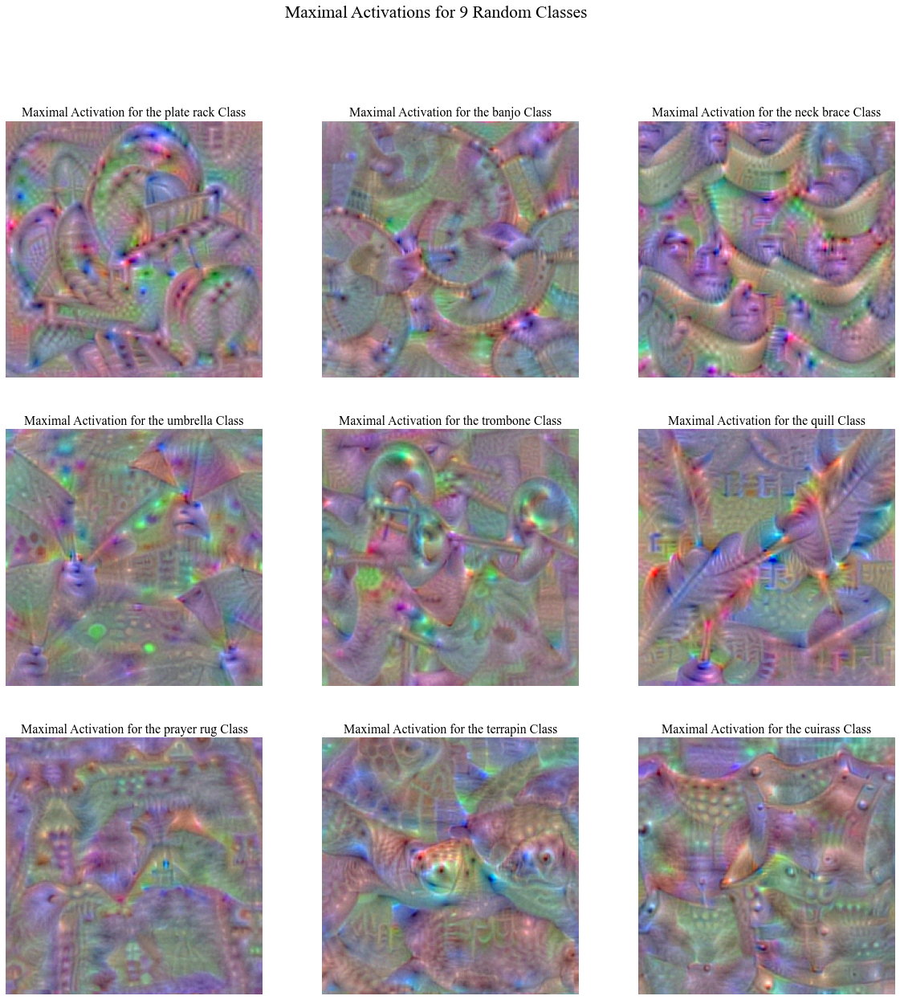

In [7]:
nrows, ncols = 3 , 3
#Seting figure size:
plt.figure(figsize=(20,20))
k = 1
for x in range(9):
    my_rand =  random.randint(1,1001)
    cat_num = my_rand
    max_act = model5_am(loss,callbacks = [tf_keras_vis.utils.callbacks.Print(interval = 50)])
    plt.subplot(nrows, ncols, k)
    plt.imshow(max_act[0,:,:,:]/255)
    plt.title('Maximal Activation for the ' + imagenet_labels[cat_num + 1] + ' Class', fontsize = 16)
    plt.axis('off')
    k += 1
plt.suptitle('Maximal Activations for 9 Random Classes')
plt.show()

#### <span style='font-family:"Times New Roman"'> <span styel=''> Maximal activations for 9 random classes are displayed. Although some features can be seen from the images, without knowing the labels, it would be difficult to accurately name the labels according to maximal activations. For instance, in umbrella cases, some features of umbrella are visible. Same discussion goes to all displayed maximal functions.  

### <span style='font-family:"Times New Roman"'> <span styel=''>(g-iv) Maximal Activations for Convolutional Layers:

Steps: 050	Losses: [[169.92974853515625]],	Regularizations: [('TotalVariation', 58.74396514892578), ('L2Norm', 0.025729820132255554)]
Steps: 100	Losses: [[193.47877502441406]],	Regularizations: [('TotalVariation', 53.7452392578125), ('L2Norm', 0.025732245296239853)]
Steps: 150	Losses: [[215.8885955810547]],	Regularizations: [('TotalVariation', 55.05909729003906), ('L2Norm', 0.025737006217241287)]
Steps: 200	Losses: [[239.03533935546875]],	Regularizations: [('TotalVariation', 57.65424346923828), ('L2Norm', 0.025737833231687546)]
Steps: 050	Losses: [[176.7711639404297]],	Regularizations: [('TotalVariation', 51.43314743041992), ('L2Norm', 0.02413681149482727)]
Steps: 100	Losses: [[323.8105773925781]],	Regularizations: [('TotalVariation', 41.55583190917969), ('L2Norm', 0.020121680572628975)]
Steps: 150	Losses: [[480.7443542480469]],	Regularizations: [('TotalVariation', 38.35707473754883), ('L2Norm', 0.01528445165604353)]
Steps: 200	Losses: [[641.2390747070312]],	Regularizations: [('TotalVa

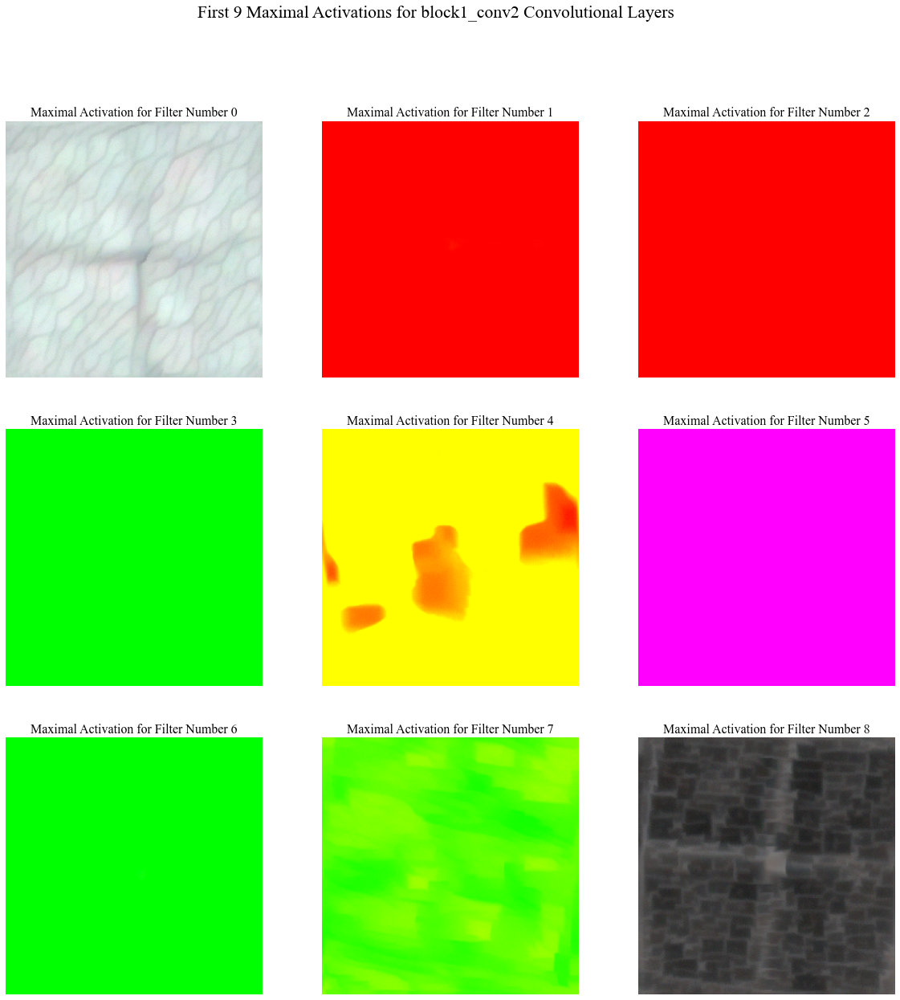

In [1]:
import tf_keras_vis.activation_maximization
import tf_keras_vis.utils.callbacks
import matplotlib.pyplot as plt 
import tensorflow as tf
import numpy as np
import random
import os


plt.rcParams["font.family"] = "Times New Roman"  # Setting Global Font to Times New Roman
plt.rcParams.update({'font.size': 18}) # Setting Global Font size


# Setting Global Path of Notebook to Avoid Hard-coding
notenookpath = os.path.abspath('') 
os.chdir(notenookpath)

model5 = tf.keras.applications.vgg16.VGG16(include_top = True, weights = 'imagenet')


def model_modifier(current_model) :
    # using layer name
    target_layer = current_model.get_layer(name = layer_name)
    # using layer number
    #target_layer=current_model.get_layer(index=layer_idx)
    new_model = tf.keras.Model(inputs = current_model.inputs, outputs  = target_layer.output)
    new_model.layers[-1].activation = tf.keras.activations.linear
    return new_model

layer_name = 'block1_conv2'


model5_am = tf_keras_vis.activation_maximization.ActivationMaximization(model5, model_modifier, clone = True)

def loss(output):
    return output[..., filter_num]


nrows, ncols = 3 , 3
#Seting figure size:
plt.figure(figsize=(20,20))
k = 1
for x in range(9):
    filter_num = x    
    max_act = model5_am(loss,callbacks = [tf_keras_vis.utils.callbacks.Print(interval = 50)])
    plt.subplot(nrows, ncols, k)
    plt.imshow(max_act[0,:,:,:]/255)
    plt.title('Maximal Activation for Filter Number '+ str(x), fontsize = 16)
    plt.axis('off')
    k += 1
plt.suptitle('First 9 Maximal Activations for block1_conv2 Convolutional Layers')
plt.show()

Steps: 050	Losses: [[2488.232666015625]],	Regularizations: [('TotalVariation', 325.5902099609375), ('L2Norm', 0.022537240758538246)]
Steps: 100	Losses: [[3648.25]],	Regularizations: [('TotalVariation', 390.16595458984375), ('L2Norm', 0.019666392356157303)]
Steps: 150	Losses: [[4755.791015625]],	Regularizations: [('TotalVariation', 465.59197998046875), ('L2Norm', 0.01746969483792782)]
Steps: 200	Losses: [[5573.404296875]],	Regularizations: [('TotalVariation', 463.4558410644531), ('L2Norm', 0.015919439494609833)]
Steps: 050	Losses: [[74.99066162109375]],	Regularizations: [('TotalVariation', 113.8783187866211), ('L2Norm', 0.0253769364207983)]
Steps: 100	Losses: [[150.58241271972656]],	Regularizations: [('TotalVariation', 123.39741516113281), ('L2Norm', 0.024751771241426468)]
Steps: 150	Losses: [[216.0545654296875]],	Regularizations: [('TotalVariation', 145.4587860107422), ('L2Norm', 0.02398063987493515)]
Steps: 200	Losses: [[262.3562316894531]],	Regularizations: [('TotalVariation', 162.67

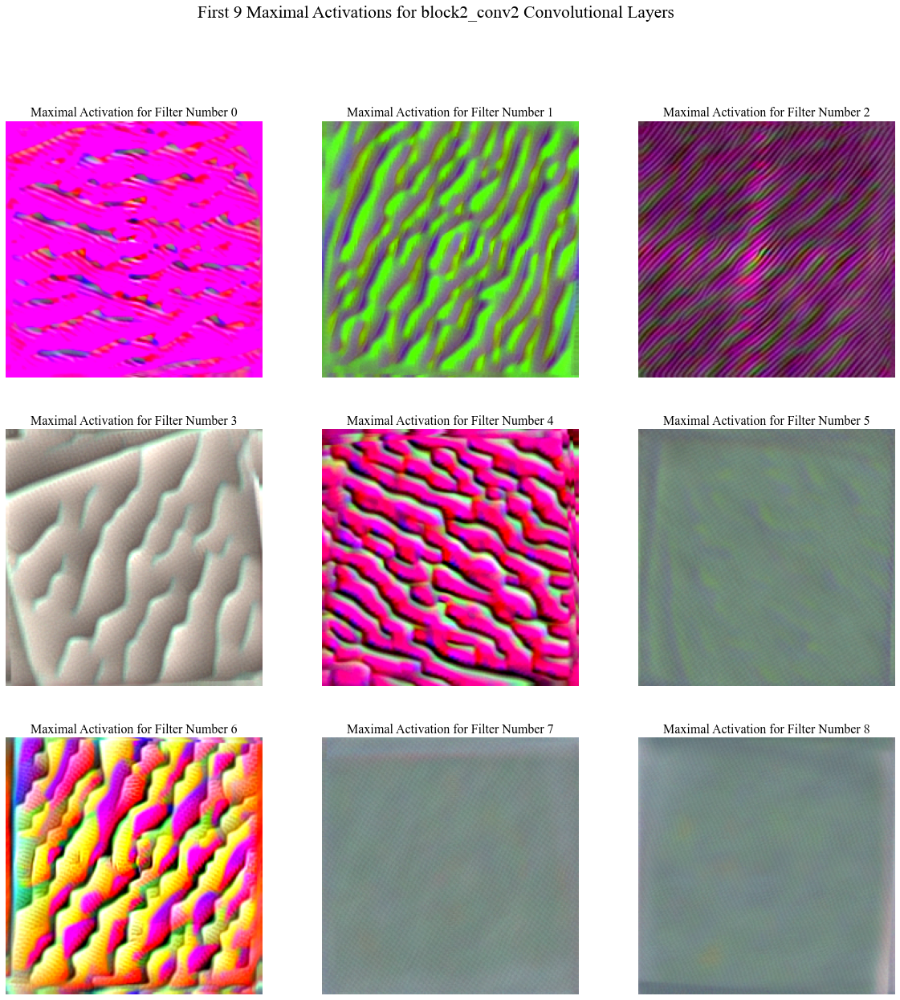

In [1]:
import tf_keras_vis.activation_maximization
import tf_keras_vis.utils.callbacks
import matplotlib.pyplot as plt 
import tensorflow as tf
import numpy as np
import random
import os


plt.rcParams["font.family"] = "Times New Roman"  # Setting Global Font to Times New Roman
plt.rcParams.update({'font.size': 18}) # Setting Global Font size


# Setting Global Path of Notebook to Avoid Hard-coding
notenookpath = os.path.abspath('') 
os.chdir(notenookpath)

model5 = tf.keras.applications.vgg16.VGG16(include_top = True, weights = 'imagenet')


def model_modifier(current_model) :
    # using layer name
    target_layer = current_model.get_layer(name = layer_name)
    # using layer number
    #target_layer=current_model.get_layer(index=layer_idx)
    new_model = tf.keras.Model(inputs = current_model.inputs, outputs  = target_layer.output)
    new_model.layers[-1].activation = tf.keras.activations.linear
    return new_model

layer_name = 'block2_conv2'


model5_am = tf_keras_vis.activation_maximization.ActivationMaximization(model5, model_modifier, clone = True)

def loss(output):
    return output[..., filter_num]


nrows, ncols = 3 , 3
#Seting figure size:
plt.figure(figsize=(20,20))
k = 1
for x in range(9):
    filter_num = x    
    max_act = model5_am(loss,callbacks = [tf_keras_vis.utils.callbacks.Print(interval = 50)])
    plt.subplot(nrows, ncols, k)
    plt.imshow(max_act[0,:,:,:]/255)
    plt.title('Maximal Activation for Filter Number '+ str(x), fontsize = 16)
    plt.axis('off')
    k += 1
plt.suptitle('First 9 Maximal Activations for block2_conv2 Convolutional Layers')
plt.show()

Steps: 050	Losses: [[3130.036376953125]],	Regularizations: [('TotalVariation', 223.63137817382812), ('L2Norm', 0.02492319606244564)]
Steps: 100	Losses: [[3838.232666015625]],	Regularizations: [('TotalVariation', 252.27020263671875), ('L2Norm', 0.024407563731074333)]
Steps: 150	Losses: [[4258.4482421875]],	Regularizations: [('TotalVariation', 267.890869140625), ('L2Norm', 0.024030210450291634)]
Steps: 200	Losses: [[4638.60546875]],	Regularizations: [('TotalVariation', 281.862060546875), ('L2Norm', 0.023737479001283646)]
Steps: 050	Losses: [[4026.18310546875]],	Regularizations: [('TotalVariation', 246.49407958984375), ('L2Norm', 0.024732735008001328)]
Steps: 100	Losses: [[5091.49560546875]],	Regularizations: [('TotalVariation', 285.00811767578125), ('L2Norm', 0.024018419906497)]
Steps: 150	Losses: [[5750.4375]],	Regularizations: [('TotalVariation', 314.0723876953125), ('L2Norm', 0.023502685129642487)]
Steps: 200	Losses: [[5910.54638671875]],	Regularizations: [('TotalVariation', 339.12896

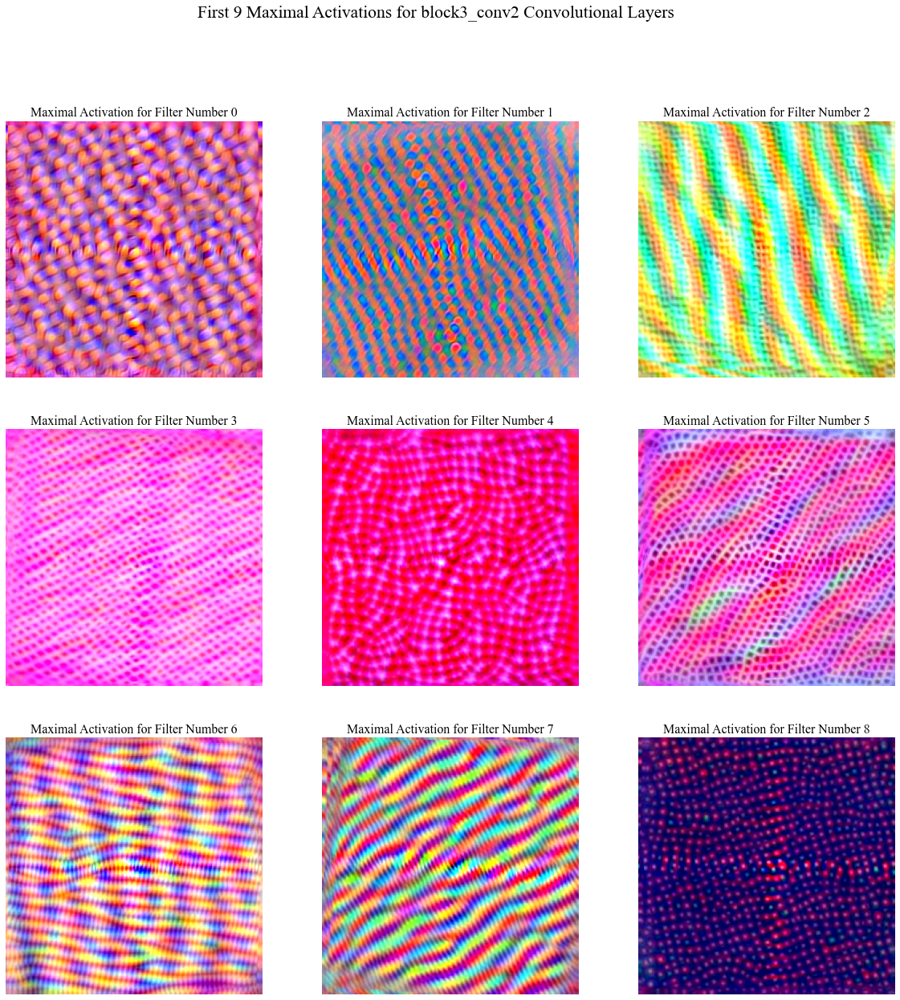

In [1]:
import tf_keras_vis.activation_maximization
import tf_keras_vis.utils.callbacks
import matplotlib.pyplot as plt 
import tensorflow as tf
import numpy as np
import random
import os


plt.rcParams["font.family"] = "Times New Roman"  # Setting Global Font to Times New Roman
plt.rcParams.update({'font.size': 18}) # Setting Global Font size


# Setting Global Path of Notebook to Avoid Hard-coding
notenookpath = os.path.abspath('') 
os.chdir(notenookpath)

model5 = tf.keras.applications.vgg16.VGG16(include_top = True, weights = 'imagenet')


def model_modifier(current_model) :
    # using layer name
    target_layer = current_model.get_layer(name = layer_name)
    # using layer number
    #target_layer=current_model.get_layer(index=layer_idx)
    new_model = tf.keras.Model(inputs = current_model.inputs, outputs  = target_layer.output)
    new_model.layers[-1].activation = tf.keras.activations.linear
    return new_model

layer_name = 'block3_conv2'


model5_am = tf_keras_vis.activation_maximization.ActivationMaximization(model5, model_modifier, clone = True)

def loss(output):
    return output[..., filter_num]


nrows, ncols = 3 , 3
#Seting figure size:
plt.figure(figsize=(20,20))
k = 1
for x in range(9):
    filter_num = x    
    max_act = model5_am(loss,callbacks = [tf_keras_vis.utils.callbacks.Print(interval = 50)])
    plt.subplot(nrows, ncols, k)
    plt.imshow(max_act[0,:,:,:]/255)
    plt.title('Maximal Activation for Filter Number '+ str(x), fontsize = 16)
    plt.axis('off')
    k += 1
plt.suptitle('First 9 Maximal Activations for block3_conv2 Convolutional Layers')
plt.show()

Steps: 050	Losses: [[3338.307373046875]],	Regularizations: [('TotalVariation', 160.37986755371094), ('L2Norm', 0.025352615863084793)]
Steps: 100	Losses: [[4284.5869140625]],	Regularizations: [('TotalVariation', 185.24188232421875), ('L2Norm', 0.02510310336947441)]
Steps: 150	Losses: [[4341.7119140625]],	Regularizations: [('TotalVariation', 184.55462646484375), ('L2Norm', 0.025004064664244652)]
Steps: 200	Losses: [[4731.5693359375]],	Regularizations: [('TotalVariation', 193.86953735351562), ('L2Norm', 0.02488388679921627)]
Steps: 050	Losses: [[2561.030517578125]],	Regularizations: [('TotalVariation', 195.52980041503906), ('L2Norm', 0.024989254772663116)]
Steps: 100	Losses: [[3447.9228515625]],	Regularizations: [('TotalVariation', 238.10655212402344), ('L2Norm', 0.0243135504424572)]
Steps: 150	Losses: [[4152.05224609375]],	Regularizations: [('TotalVariation', 271.7310791015625), ('L2Norm', 0.023743968456983566)]
Steps: 200	Losses: [[4096.3486328125]],	Regularizations: [('TotalVariation',

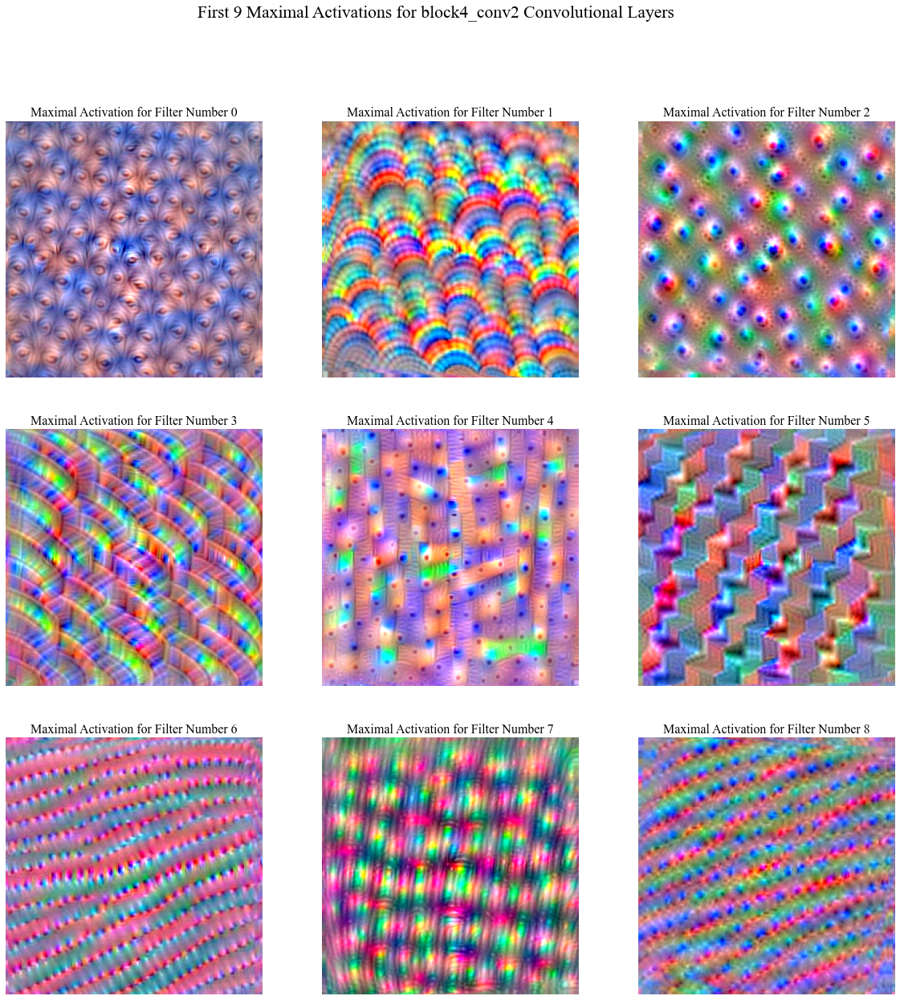

In [1]:
import tf_keras_vis.activation_maximization
import tf_keras_vis.utils.callbacks
import matplotlib.pyplot as plt 
import tensorflow as tf
import numpy as np
import random
import os


plt.rcParams["font.family"] = "Times New Roman"  # Setting Global Font to Times New Roman
plt.rcParams.update({'font.size': 18}) # Setting Global Font size


# Setting Global Path of Notebook to Avoid Hard-coding
notenookpath = os.path.abspath('') 
os.chdir(notenookpath)

model5 = tf.keras.applications.vgg16.VGG16(include_top = True, weights = 'imagenet')


def model_modifier(current_model) :
    # using layer name
    target_layer = current_model.get_layer(name = layer_name)
    # using layer number
    #target_layer=current_model.get_layer(index=layer_idx)
    new_model = tf.keras.Model(inputs = current_model.inputs, outputs  = target_layer.output)
    new_model.layers[-1].activation = tf.keras.activations.linear
    return new_model

layer_name = 'block4_conv2'


model5_am = tf_keras_vis.activation_maximization.ActivationMaximization(model5, model_modifier, clone = True)

def loss(output):
    return output[..., filter_num]


nrows, ncols = 3 , 3
#Seting figure size:
plt.figure(figsize=(20,20))
k = 1
for x in range(9):
    filter_num = x    
    max_act = model5_am(loss,callbacks = [tf_keras_vis.utils.callbacks.Print(interval = 50)])
    plt.subplot(nrows, ncols, k)
    plt.imshow(max_act[0,:,:,:]/255)
    plt.title('Maximal Activation for Filter Number '+ str(x), fontsize = 16)
    plt.axis('off')
    k += 1
plt.suptitle('First 9 Maximal Activations for block4_conv2 Convolutional Layers')
plt.show()

Steps: 050	Losses: [[550.6232299804688]],	Regularizations: [('TotalVariation', 114.60562133789062), ('L2Norm', 0.025475379079580307)]
Steps: 100	Losses: [[825.9783325195312]],	Regularizations: [('TotalVariation', 127.52272033691406), ('L2Norm', 0.02522852085530758)]
Steps: 150	Losses: [[840.4340209960938]],	Regularizations: [('TotalVariation', 133.97421264648438), ('L2Norm', 0.025023773312568665)]
Steps: 200	Losses: [[1102.6619873046875]],	Regularizations: [('TotalVariation', 144.38941955566406), ('L2Norm', 0.0248250775039196)]
Steps: 050	Losses: [[570.6882934570312]],	Regularizations: [('TotalVariation', 128.4097442626953), ('L2Norm', 0.025447726249694824)]
Steps: 100	Losses: [[675.1707763671875]],	Regularizations: [('TotalVariation', 145.4986572265625), ('L2Norm', 0.025258347392082214)]
Steps: 150	Losses: [[750.8275756835938]],	Regularizations: [('TotalVariation', 150.923828125), ('L2Norm', 0.02512010931968689)]
Steps: 200	Losses: [[810.5551147460938]],	Regularizations: [('TotalVaria

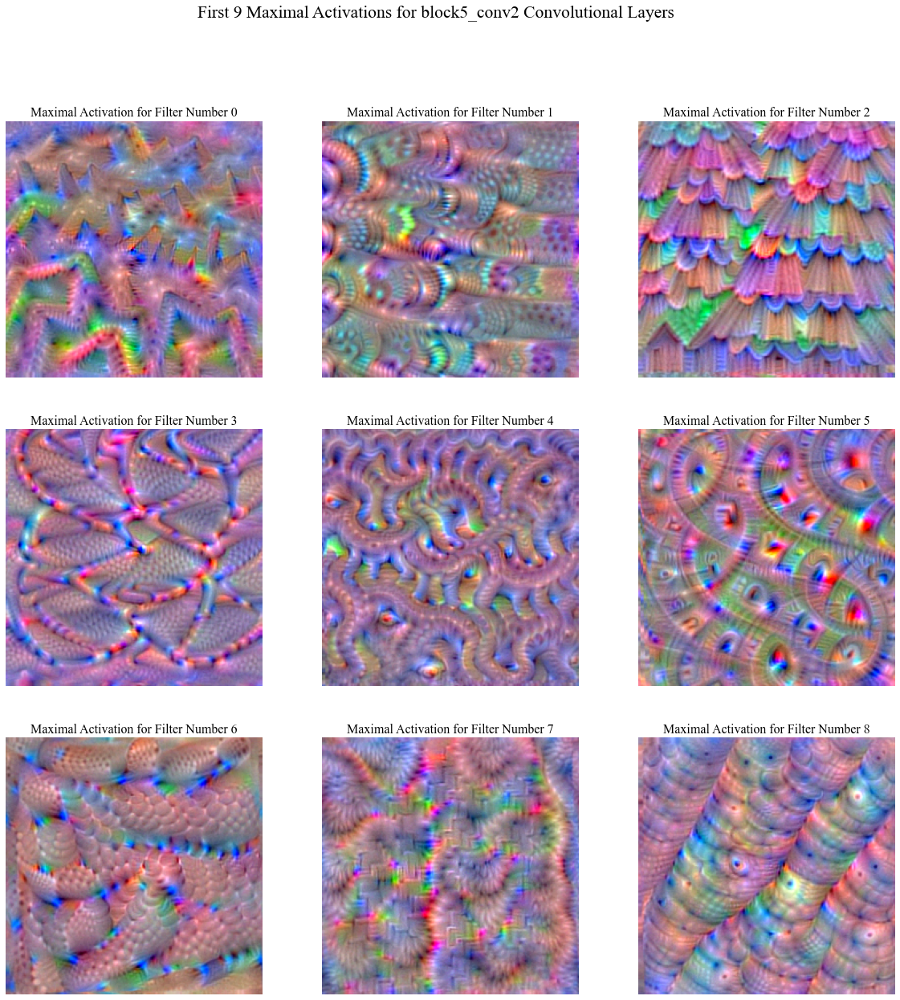

In [1]:
import tf_keras_vis.activation_maximization
import tf_keras_vis.utils.callbacks
import matplotlib.pyplot as plt 
import tensorflow as tf
import numpy as np
import random
import os


plt.rcParams["font.family"] = "Times New Roman"  # Setting Global Font to Times New Roman
plt.rcParams.update({'font.size': 18}) # Setting Global Font size


# Setting Global Path of Notebook to Avoid Hard-coding
notenookpath = os.path.abspath('') 
os.chdir(notenookpath)

model5 = tf.keras.applications.vgg16.VGG16(include_top = True, weights = 'imagenet')


def model_modifier(current_model) :
    # using layer name
    target_layer = current_model.get_layer(name = layer_name)
    # using layer number
    #target_layer=current_model.get_layer(index=layer_idx)
    new_model = tf.keras.Model(inputs = current_model.inputs, outputs  = target_layer.output)
    new_model.layers[-1].activation = tf.keras.activations.linear
    return new_model

layer_name = 'block5_conv2'


model5_am = tf_keras_vis.activation_maximization.ActivationMaximization(model5, model_modifier, clone = True)

def loss(output):
    return output[..., filter_num]


nrows, ncols = 3 , 3
#Seting figure size:
plt.figure(figsize=(20,20))
k = 1
for x in range(9):
    filter_num = x    
    max_act = model5_am(loss,callbacks = [tf_keras_vis.utils.callbacks.Print(interval = 50)])
    plt.subplot(nrows, ncols, k)
    plt.imshow(max_act[0,:,:,:]/255)
    plt.title('Maximal Activation for Filter Number '+ str(x), fontsize = 16)
    plt.axis('off')
    k += 1
plt.suptitle('First 9 Maximal Activations for block5_conv2 Convolutional Layers')
plt.show()

#### <span style='font-family:"Times New Roman"'> <span styel=''>The visualization of the maximal activations for 9+ ImageNet filters in each of the 13 VGG16 convolutional layers is presented in this subsection. As we move forward in our layers, the extracted features become abstract and understand them for human concept does not seem possible. In early layers, these filters are simple colors or simple edges. As we move forward in layers, the filters start to be more abstract and it wouldn’t be possible to understand by human conception which images we are looking for or what features they are representing. 

### <span style='font-family:"Times New Roman"'> <span styel=''>(g-v) (2% Extra Credit) Saliency for Image Classes:

In [3]:
from tensorflow.keras.applications.vgg16 import preprocess_input
from tensorflow.keras.applications.vgg16 import VGG16 as Model
from tensorflow.keras.preprocessing.image import load_img
from matplotlib import pyplot as plt
import tensorflow as tf
import numpy as np


%matplotlib inline

In [2]:
# Load model
modelfinal = Model(weights='imagenet', include_top=True)

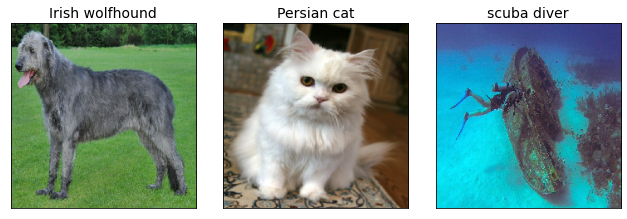

In [6]:
# Image titles
image_titles = ['Irish wolfhound', 'Persian cat', 'scuba diver']

# Load images
img1 = load_img('Irish_wolfhound.jpg', target_size=(224, 224))
img2 = load_img('Persian_cat.jpg', target_size=(224, 224))
img3 = load_img('scuba_diver.jpg', target_size=(224, 224))
images = np.asarray([np.array(img1), np.array(img2), np.array(img3)])

# Preparing input data
X = preprocess_input(images)

# Rendering
subplot_args = { 'nrows': 1, 'ncols': 3, 'figsize': (9, 3),
                 'subplot_kw': {'xticks': [], 'yticks': []} }
f, ax = plt.subplots(**subplot_args)
for i, title in enumerate(image_titles):
    ax[i].set_title(title, fontsize=14)
    ax[i].imshow(images[i])
plt.tight_layout()
plt.show()

In [7]:
def loss(output):
    # 170 is the imagenet index corresponding to Irish wolfhound, 283 to Persian cat
    # and 983 to scuba diver.
    return (output[0][170], output[1][283], output[2][983])

In [8]:
def model_modifier(m):
    m.layers[-1].activation = tf.keras.activations.linear
    return m

#### <span style='font-family:"Times New Roman"'> <span styel=''> Vanilla Saliency:

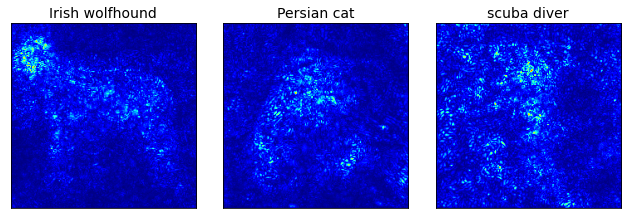

In [12]:
from tensorflow.keras import backend as K
from tf_keras_vis.saliency import Saliency
from tf_keras_vis.utils import normalize

# Create Saliency object.
# If `clone` is True(default), the `model` will be cloned,
# so the `model` instance will be NOT modified, but it takes a machine resources.
saliency = Saliency(modelfinal,
                    model_modifier=model_modifier,
                    clone=False)

# Generate saliency map
saliency_map = saliency(loss, X)
saliency_map = normalize(saliency_map)

# Render
f, ax = plt.subplots(**subplot_args)
for i, title in enumerate(image_titles):
    ax[i].set_title(title, fontsize=14)
    ax[i].imshow(saliency_map[i], cmap='jet')
plt.tight_layout()
plt.show()

#### <span style='font-family:"Times New Roman"'> <span styel=''> GradCAM (Gradient-weighted Class Activation Mapping):

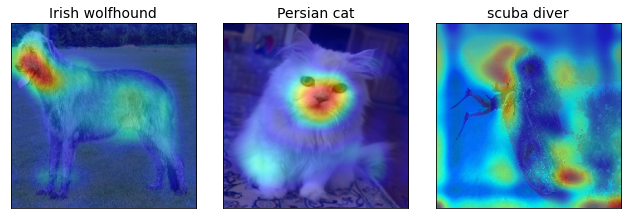

Wall time: 602 ms


In [13]:
%%time

from matplotlib import cm
from tf_keras_vis.gradcam import Gradcam

# Create Gradcam object
gradcam = Gradcam(modelfinal,
                  model_modifier=model_modifier,
                  clone=False)

# Generate heatmap with GradCAM
cam = gradcam(loss,
              X,
              penultimate_layer=-1, # model.layers number
             )
cam = normalize(cam)

f, ax = plt.subplots(**subplot_args)
for i, title in enumerate(image_titles):
    heatmap = np.uint8(cm.jet(cam[i])[..., :3] * 255)
    ax[i].set_title(title, fontsize=14)
    ax[i].imshow(images[i])
    ax[i].imshow(heatmap, cmap='jet', alpha=0.5) # overlay
plt.tight_layout()
plt.show()

#### <span style='font-family:"Times New Roman"'> <span styel=''>Three different images from three different categories are selected. An Irish wolfhound, Persian cat, and scuba diver.
#### <span style='font-family:"Times New Roman"'> <span styel=''>According to Vanilla Saliency results and Gradcam results, VGG16 is doing good when dealing with cat and dog picture but cueing wrong when dealing with scuba diver image.
#### <span style='font-family:"Times New Roman"'> <span styel=''>For Persian cat and Irish wolfhound, the network cues on animal faces strongly and then some of their body parts.  
#### <span style='font-family:"Times New Roman"'> <span styel=''>However, on the scuba diver it has cued on irrelevant information like strongly like edge of corroded ship or corral reefs.  


## <span style='font-family:"Times New Roman"'> <span styel=''> (h) Summary

#### <span style='font-family:"Times New Roman"'> <span styel=''>In this project, first the concepts of generating deep networks investigated. Then the performance of CNNs on different datasets considered. 
#### <span style='font-family:"Times New Roman"'> <span styel=''>We showed that CNNs are strong methods for classification means when enough training data (MNIST) is available. However, in small datasets, there is a good chance that classification methods based on feature extraction like SVM, outperform them. 
#### <span style='font-family:"Times New Roman"'> <span styel=''>Then, we delved into the network by displaying their activations in different convolutional layers to have a grasp of what features does network try to extract and how the learning process is. We showed that as we move forward in layers, the features become abstract for human conception. It was interesting to see how CNNs are learning features without prior knowledge.
#### <span style='font-family:"Times New Roman"'> <span styel=''>We use CNN for classification every day in our life. When receiving an Email, or when taking a picture in our smart phone, CNN are classifying spam emails, or trying to classify our face. However, we do not know how these data are being stored and who have access to them and how it may be used in the future when it comes to face detection. 
#### <span style='font-family:"Times New Roman"'> <span styel=''>The main issue in training CNNs are enough GPU. Training on GPU is much faster and as you increase your GPU power, you can increase the timing efficiency. Also, in most of the cases, we may have database problem. It is mentioned that CNN would do poorly if our train dataset is small.  
